<a href="https://colab.research.google.com/github/goldboy225/Intelligent-IoT-Security-Frameworks/blob/main/Lightweight_TON_IoT_Framework_Pipeline.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Code Revision


## Revision in Preprocessing Stage
- 2023.06.21 PM 11:54, 3.3.1 section, find some features with constant value, the issues is we direclty applied the object type to "1", have already fixed by converting to numerical type, then to apply lamda.
Other object type features are needed to be transformed for binary encoding...
- 2023.06.23 PM 11:56, 3.3.1 section, encoding work for binary encoding has been completed, encoded data is ready now.
- 2023.06.24 16:36, 4.1.1 section, trying to implement correlation feature selection with score >0.9, but it seems there is an error when combing into a dataset after transformed, need time to figure it out...
- 2023.06.25 code to be updated, one is we need firstly split the dataset then do normalization and feature selection, in order to aviod data leak, furthermore, whole training data should be used for the last model training after model cross-validation. (TODO)
...
- 2023.07.13 1. label encode should be supported in pre-processing stage; 2. ensemble FS should be applied to get informative features, plan to use corr + mi + pca; (TODO)

Check the configuration of current environment

In [ ]:
!pip install psutil cpuinfo

import platform
import psutil

# Retrieve hardware information
cpu_info = platform.processor()
total_memory = psutil.virtual_memory().total
disk_usage = psutil.disk_usage('/')

# Retrieve operating system information
system_info = platform.uname()

# Retrieve software environment information
python_version = platform.python_version()
libraries = [name for name in sorted(set(globals()) | set(dir(__builtins__))) if not name.startswith('_') and name.islower()]

# Print the system information
print("=== Hardware Information ===")
print("CPU Model:", cpu_info)
print("Total Memory:", round(total_memory / (1024 ** 3), 2), "GB")
print("Disk Usage:", round(disk_usage.used / (1024 ** 3), 2), "GB used /",
      round(disk_usage.total / (1024 ** 3), 2), "GB total")

print("\n=== Operating System Information ===")
print("System:", system_info.system)
print("Node Name:", system_info.node)
print("Release:", system_info.release)
print("Version:", system_info.version)
print("Machine:", system_info.machine)

print("\n=== Software Environment Information ===")
print("Python Version:", python_version)



Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
ERROR: Could not find a version that satisfies the requirement cpuinfo (from versions: none)
ERROR: No matching distribution found for cpuinfo
=== Hardware Information ===
CPU Model: x86_64
Total Memory: 12.68 GB
Disk Usage: 24.06 GB used / 107.72 GB total

=== Operating System Information ===
System: Linux
Node Name: ab6842de049d
Release: 5.15.107+
Version: #1 SMP Sat Apr 29 09:15:28 UTC 2023
Machine: x86_64

=== Software Environment Information ===
Python Version: 3.10.12


Mount the google drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# 1. Data Collection

## 1.1 Import libraries

In [ ]:
# install 3rd party lib for lightweight pandas
# https://modin.readthedocs.io/en/stable/ https://github.com/modin-project/modin

#pip install modin

SyntaxError: ignored

In [ ]:
# data cleaning and plots
import pandas as pd
#import modin.pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
plt.style.use('ggplot')
%matplotlib inline

# sklearn: data preprocessing
from sklearn.preprocessing import MinMaxScaler
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, LabelEncoder, OneHotEncoder
import missingno

# sklearn: train model
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score, cross_validate, StratifiedKFold
from sklearn.metrics import precision_recall_curve, precision_score, recall_score, f1_score, accuracy_score
#from sklearn.metrics import roc_curve, auc, roc_auc_score, confusion_matrix, classification_report, plot_roc_curve

# sklearn classifiers
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier

# optimization algorithms
from sklearn.model_selection import GridSearchCV
import itertools
import matplotlib.gridspec as gridspec

# timestamp for noting time resource operation
from pandas import Timestamp

# os lib
import os  # print ("current directory : %s" % os.getcwd())

# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

## 1.2 Load the dataset

In [ ]:
# load the original dataset, which have not been processed by the authors
df = pd.read_csv('/content/drive/MyDrive/Datasets/TON-IoT/Train_Test_Network.csv')

## 1.3 Data Sanity Check

In [ ]:
# Check the dataframe

df.head(10)

,ts,src_ip,src_port,dst_ip,dst_port,proto,service,duration,src_bytes,dst_bytes,...,http_response_body_len,http_status_code,http_user_agent,http_orig_mime_types,http_resp_mime_types,weird_name,weird_addl,weird_notice,label,type
0,1554198358,3.122.49.24,1883,192.168.1.152,52976,tcp,-,80549.530260,1762852,41933215,...,0,0,-,-,-,bad_TCP_checksum,-,F,0,normal
1,1554198358,192.168.1.79,47260,192.168.1.255,15600,udp,-,0.000000,0,0,...,0,0,-,-,-,-,-,-,0,normal
2,1554198359,192.168.1.152,1880,192.168.1.152,51782,tcp,-,0.000000,0,0,...,0,0,-,-,-,bad_TCP_checksum,-,F,0,normal
3,1554198359,192.168.1.152,34296,192.168.1.152,10502,tcp,-,0.000000,0,0,...,0,0,-,-,-,-,-,-,0,normal
4,1554198362,192.168.1.152,46608,192.168.1.190,53,udp,dns,0.000549,0,298,...,0,0,-,-,-,bad_UDP_checksum,-,F,0,normal
5,1554198364,192.168.1.79,33269,192.168.1.255,15600,udp,-,0.000000,0,0,...,0,0,-,-,-,-,-,-,0,normal
6,1554198364,192.168.1.152,34296,192.168.1.152,10502,tcp,-,0.000000,0,0,...,0,0,-,-,-,-,-,-,0,normal
7,1554198364,192.168.1.152,1880,192.168.1.152,51782,tcp,-,0.000000,0,0,...,0,0,-,-,-,-,-,-,0,normal
8,1554198369,192.168.1.152,1880,192.168.1.152,51782,tcp,-,0.000000,0,0,...,0,0,-,-,-,-,-,-,0,normal
9,1554198369,192.168.1.152,34296,192.168.1.152,10502,tcp,-,0.000000,0,0,...,0,0,-,-,-,-,-,-,0,normal


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 461043 entries, 0 to 461042
Data columns (total 45 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   ts                      461043 non-null  int64  
 1   src_ip                  461043 non-null  object 
 2   src_port                461043 non-null  int64  
 3   dst_ip                  461043 non-null  object 
 4   dst_port                461043 non-null  int64  
 5   proto                   461043 non-null  object 
 6   service                 461043 non-null  object 
 7   duration                461043 non-null  float64
 8   src_bytes               461043 non-null  int64  
 9   dst_bytes               461043 non-null  int64  
 10  conn_state              461043 non-null  object 
 11  missed_bytes            461043 non-null  int64  
 12  src_pkts                461043 non-null  int64  
 13  src_ip_bytes            461043 non-null  int64  
 14  dst_pkts            

In [ ]:
# check the size of the data

print(df.shape)

(461043, 45)


In [ ]:
# Check the columns of the data

print(df.columns)

Index(['ts', 'src_ip', 'src_port', 'dst_ip', 'dst_port', 'proto', 'service',
       'duration', 'src_bytes', 'dst_bytes', 'conn_state', 'missed_bytes',
       'src_pkts', 'src_ip_bytes', 'dst_pkts', 'dst_ip_bytes', 'dns_query',
       'dns_qclass', 'dns_qtype', 'dns_rcode', 'dns_AA', 'dns_RD', 'dns_RA',
       'dns_rejected', 'ssl_version', 'ssl_cipher', 'ssl_resumed',
       'ssl_established', 'ssl_subject', 'ssl_issuer', 'http_trans_depth',
       'http_method', 'http_uri', 'http_version', 'http_request_body_len',
       'http_response_body_len', 'http_status_code', 'http_user_agent',
       'http_orig_mime_types', 'http_resp_mime_types', 'weird_name',
       'weird_addl', 'weird_notice', 'label', 'type'],
      dtype='object')


In [ ]:
df.describe(include = 'all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
ts,461043.0,NaN,NaN,NaN,1555623627.017374,945923.406423,1554198358.0,1554294210.5,1556240048.0,1556326776.0,1556549129.0
src_ip,461043,11536,192.168.1.190,77033,NaN,NaN,NaN,NaN,NaN,NaN,NaN
src_port,461043.0,NaN,NaN,NaN,39326.395095,18469.455055,1.0,34296.0,43530.0,52724.5,65534.0
dst_ip,461043,5268,192.168.1.190,80102,NaN,NaN,NaN,NaN,NaN,NaN,NaN
dst_port,461043.0,NaN,NaN,NaN,7759.445861,13943.625464,0.0,53.0,136.0,9197.0,65530.0
proto,461043,3,tcp,282076,NaN,NaN,NaN,NaN,NaN,NaN,NaN
service,461043,10,-,280216,NaN,NaN,NaN,NaN,NaN,NaN,NaN
duration,461043.0,NaN,NaN,NaN,8.473511,458.37939,0.0,0.0,0.000036,0.022757,93516.92917
src_bytes,461043.0,NaN,NaN,NaN,120992.636754,11572796.127046,0.0,0.0,0.0,55.0,3890855126.0
dst_bytes,461043.0,NaN,NaN,NaN,119693.146364,12196967.716699,0.0,0.0,0.0,250.0,3913853482.0


# 2. Exploration Data Analysis (EDA)

## 2.1 Check the count and distribution of target classes

In [ ]:
# to install matplotlib in order to show the figure in the following steps

#! python -m pip uninstall matplotlib
#! pip install matplotlib==3.1.3


# Check the count of normal and attack class

counts = df.value_counts('label')
print(counts)

label
0    300000
1    161043
dtype: int64


AttributeError: ignored

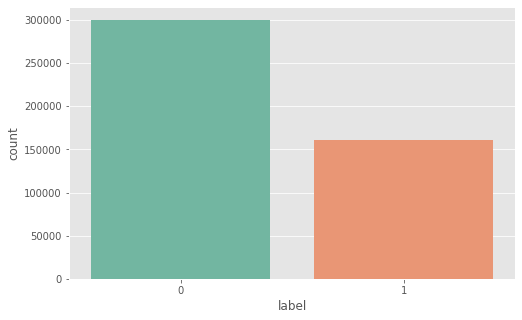

In [ ]:
# let's see the distribution of our target normal/attack by bar chart

plt.figure(figsize=(8,5))
ax = sns.countplot(x = 'label', data = df, palette = 'Set2')
for container in ax.containers:
    ax.bar_label(container)

In [ ]:
# Check the count of category class

counts = df.value_counts('type')
print(counts)

type
normal        300000
backdoor       20000
ddos           20000
dos            20000
injection      20000
password       20000
ransomware     20000
scanning       20000
xss            20000
mitm            1043
dtype: int64


AttributeError: ignored

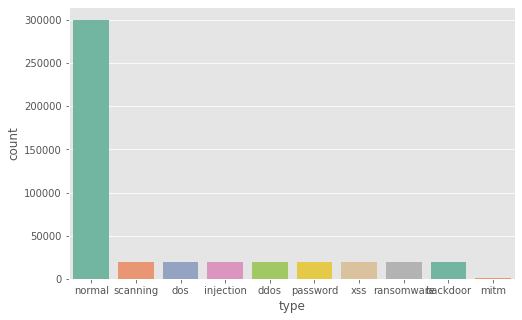

In [ ]:
# let's see the distribution of our target category by bar chart

plt.figure(figsize=(8,5))
ax = sns.countplot(x = 'type', data = df, palette = 'Set2')
for container in ax.containers:
    ax.bar_label(container)

In [ ]:
# helper function for drawing mulitple charts.

def bake_pies(data_list,labels):
    list_length = len(data_list)

    # setup for mapping colors
    color_list = sns.color_palette()
    color_cycle = itertools.cycle(color_list)
    cdict = {}

    # build the subplots
    fig, axs = plt.subplots(1, list_length,figsize=(18,10), tight_layout=False)
    plt.subplots_adjust(wspace=1/list_length)

    # loop through the data sets and build the charts
    for count, data_set in enumerate(data_list):
        # update our color mapt with new values
        for num, value in enumerate(np.unique(data_set.index)):
            if value not in cdict:
                cdict[value] = next(color_cycle)

        # build the wedges
        wedges,texts = axs[count].pie(data_set,
                           colors=[cdict[v] for v in data_set.index])

        # build the legend
        axs[count].legend(wedges, data_set.index,
                           title="Flags",
                           loc="center left",
                           bbox_to_anchor=(1, 0, 0.5, 1))
        # set the title
        axs[count].set_title(labels[count])

    return axs

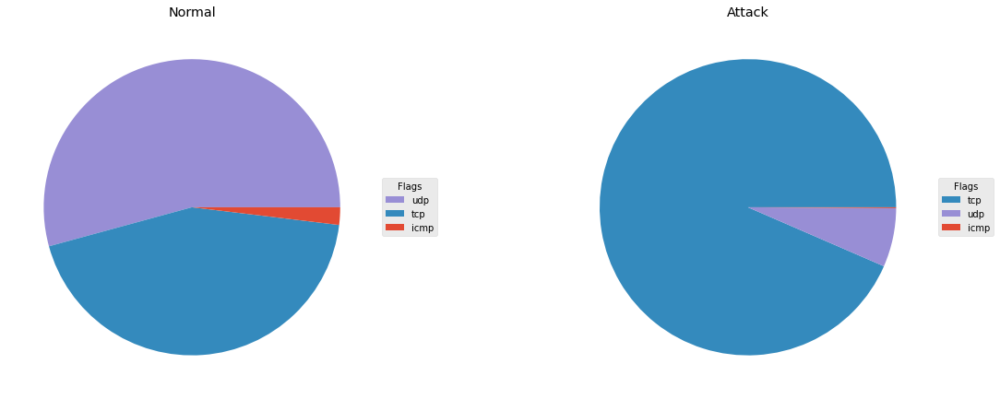

In [ ]:
# Use pie chart to show the distribution of the target classes based on the protocols

normal_protocol = df.loc[df.label == 0].proto.value_counts()
attack_protocol = df.loc[df.label == 1].proto.value_counts()

protocol_axs = bake_pies([normal_protocol, attack_protocol], ['Normal','Attack'])
plt.show()

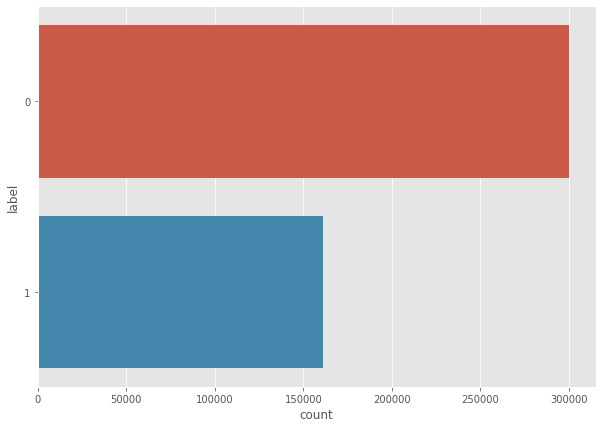

In [ ]:
# let's see the target classses using another bar chart

plt.figure(figsize=(10,7))
sns.countplot(y='label' , data=df, order = df['label'].value_counts().index)

## 2.2 Check the corrlelation between variables

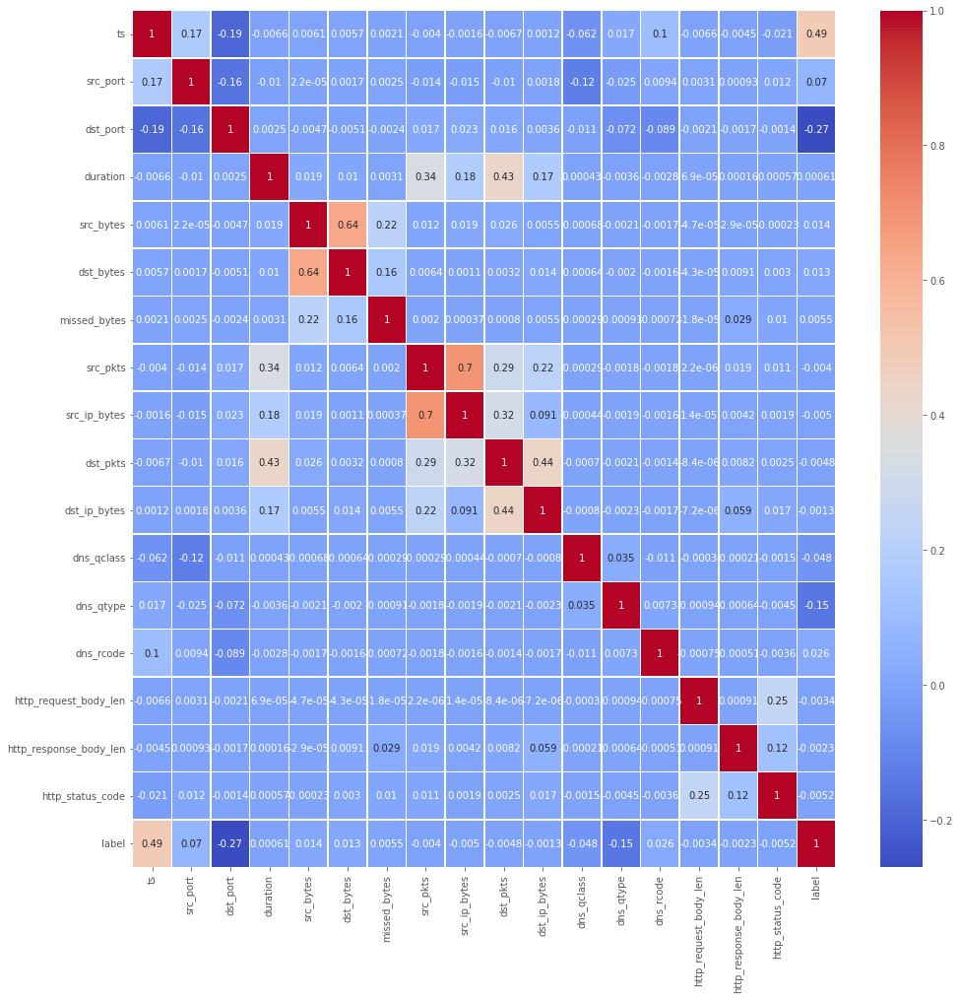

In [ ]:
# Check the correlation matrix between among the attributes

corr = df.corr()
#sns.heatmap(corr, annot=True, cmap='coolwarm')

fig, ax = plt.subplots(figsize=(16,16))         # Sample figsize in inches
sns.heatmap(corr, annot = True, cmap='coolwarm', linewidths=.5, ax=ax)

AttributeError: ignored

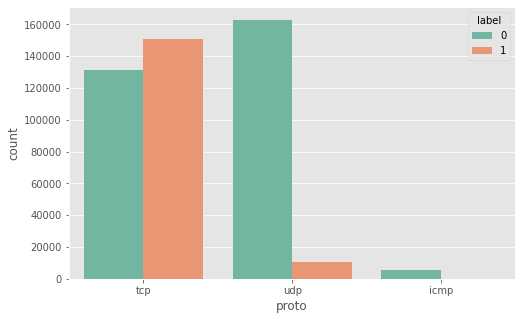

In [ ]:
# let's see protocol type vs. our target(attack) by bar chart

plt.figure(figsize=(8,5))
ax = sns.countplot(x='proto', hue='label', data = df, palette ='Set2')
for container in ax.containers:
    ax.bar_label(container)

## 2.3 Check the distribution for the features

In [ ]:
# Define history plot function for statistic features

def plot_hist(df, cols, title):
    grid = gridspec.GridSpec(10, 2, wspace=0.5, hspace=0.5)
    fig = plt.figure(figsize=(20,30))

    for n, col in enumerate(df[cols]):
        ax = plt.subplot(grid[n])

        ax.hist(df[col], bins=20)
        #ax.set_ylabel('Count', fontsize=12)
        ax.set_title(f'{col} distribution', fontsize=15)
    fig.suptitle(title, fontsize=20)
    grid.tight_layout(fig, rect=[0, 0, 1, 0.97])
    plt.show()

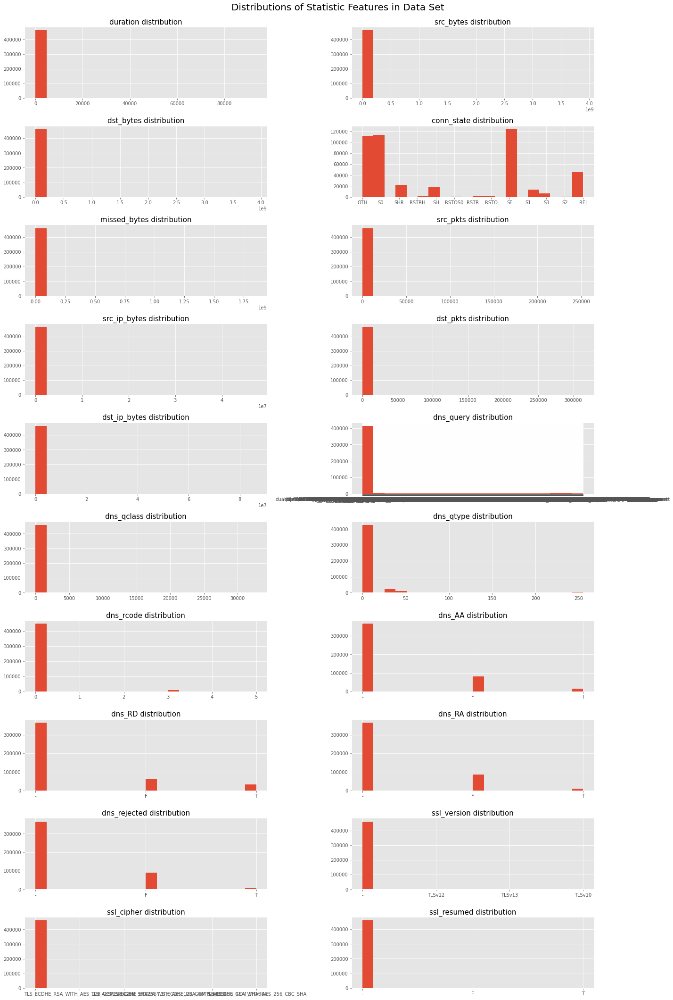

In [ ]:
# using plot_hist function to present plot history of selected statistic features

hist_cols = [ 'duration', 'src_bytes', 'dst_bytes', 'conn_state', 'missed_bytes', \
              'src_pkts', 'src_ip_bytes', 'dst_pkts', 'dst_ip_bytes', 'dns_query', \
              'dns_qclass', 'dns_qtype', 'dns_rcode', 'dns_AA', 'dns_RD', 'dns_RA', \
              'dns_rejected', 'ssl_version', 'ssl_cipher', 'ssl_resumed', \
#              'ssl_established', 'ssl_subject', 'ssl_issuer', 'http_trans_depth', \
#              'http_method', 'http_uri', 'http_version', 'http_request_body_len', \
#              'http_response_body_len', 'http_status_code', 'http_user_agent', \
#              'http_orig_mime_types', 'http_resp_mime_types', 'weird_name', \
#              'weird_addl', 'weird_notice'
            ]

plot_hist(df, hist_cols, 'Distributions of Statistic Features in Data Set')

ValueError: ignored

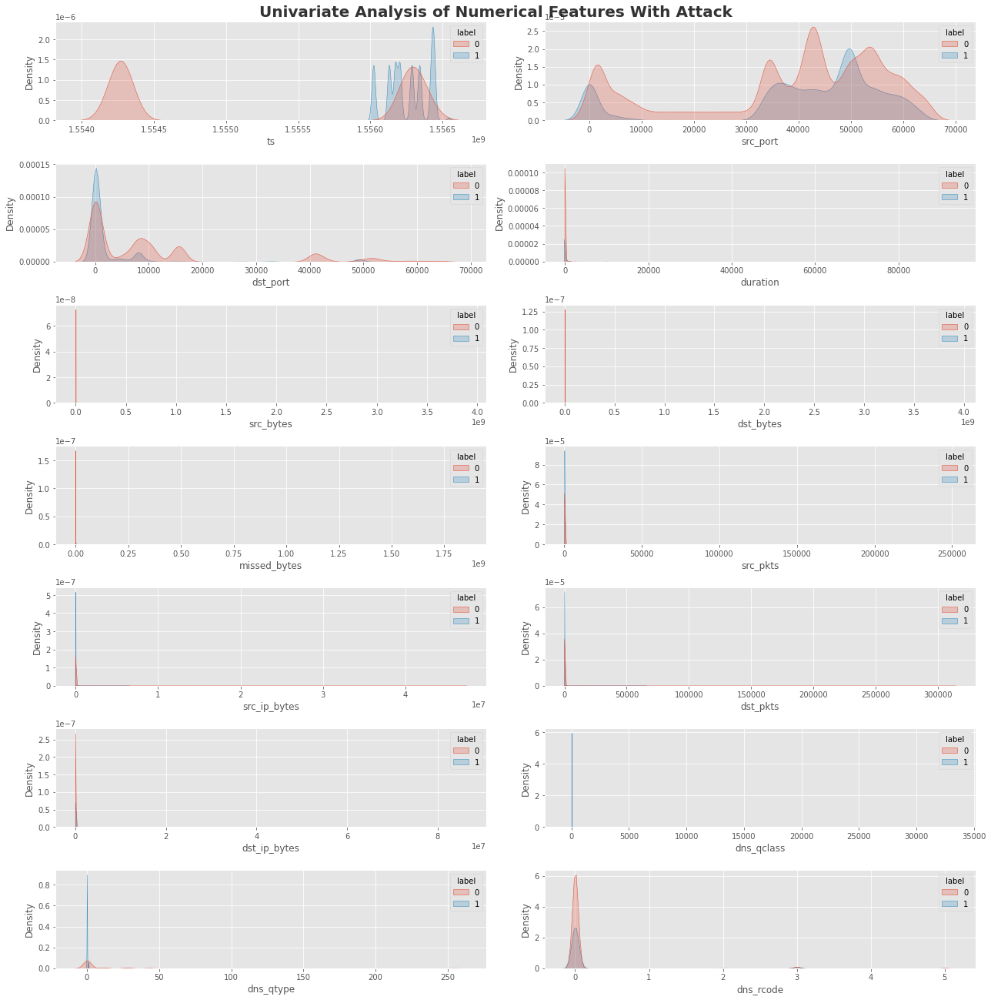

In [ ]:
# Check distribution of each feature towards attack

numeric_features = [i for i in df.columns if df[i].dtype!='O']
categorical_features = [i for i in df.columns if df[i].dtype =='O']

plt.figure(figsize=(18,18))
plt.suptitle('Univariate Analysis of Numerical Features With Attack', fontsize=20, fontweight='bold', alpha=0.8, y=1.)

for i in range(0, len(numeric_features)):
    plt.subplot(7, 2, i+1)
    sns.kdeplot(x= df[numeric_features[i]], shade=True, hue='label' ,data=df)
    plt.xlabel(numeric_features[i])
    plt.tight_layout()

In [ ]:
for i in df.columns:
    plt.figure(figsize=(18,18))
    sns.displot(data= df,x=i,hue='label',kind='hist')

## 2.4 Check the outlier of each feature

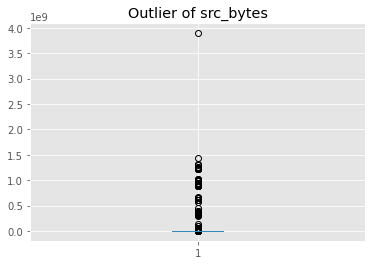

In [ ]:
#plot the outlier of the feature

plt.boxplot(df['src_bytes'])
plt.title('Outlier of src_bytes')
plt.show()

# 3. Data Pre-processing

## 3.1 Handle missing value#

In [ ]:
# check the count of missing value
df.isnull().sum()

# check the count of missing value
df.isna().sum()

ts                        0
src_ip                    0
src_port                  0
dst_ip                    0
dst_port                  0
proto                     0
service                   0
duration                  0
src_bytes                 0
dst_bytes                 0
conn_state                0
missed_bytes              0
src_pkts                  0
src_ip_bytes              0
dst_pkts                  0
dst_ip_bytes              0
dns_query                 0
dns_qclass                0
dns_qtype                 0
dns_rcode                 0
dns_AA                    0
dns_RD                    0
dns_RA                    0
dns_rejected              0
ssl_version               0
ssl_cipher                0
ssl_resumed               0
ssl_established           0
ssl_subject               0
ssl_issuer                0
http_trans_depth          0
http_method               0
http_uri                  0
http_version              0
http_request_body_len     0
http_response_body_l

In [ ]:
# show the features that contain '-' value, which can be regarded as missing value

features_with_missing_value = df.columns[df.isin(['-']).any()]
features_with_missing_value

Index(['service', 'dns_query', 'dns_AA', 'dns_RD', 'dns_RA', 'dns_rejected',
       'ssl_version', 'ssl_cipher', 'ssl_resumed', 'ssl_established',
       'ssl_subject', 'ssl_issuer', 'http_trans_depth', 'http_method',
       'http_uri', 'http_version', 'http_user_agent', 'http_orig_mime_types',
       'http_resp_mime_types', 'weird_name', 'weird_addl', 'weird_notice'],
      dtype='object')

**=> 'service', "dns_xxx", "ssl_xxx", "http_xxx" and
"weird_xxx" features have "-" value, so the next step is to figure out the meaning of the features and why "-" exists in the data.**



In [ ]:
# show the instances that contain '-' value, which can be regarded as missing value
mask = (df == '-').any(axis=1)
indices = df.loc[mask].index
indices

Int64Index([     0,      1,      2,      3,      4,      5,      6,      7,
                 8,      9,
            ...
            461033, 461034, 461035, 461036, 461037, 461038, 461039, 461040,
            461041, 461042],
           dtype='int64', length=461043)

=> The output shows that each instance has at least one "-" value in any feature

In [ ]:
# Check the value counts for the features

df["service"].value_counts()

-             280216
dns           116480
http           60720
ssl             2070
ftp             1065
gssapi           184
dce_rpc          136
smb              108
dhcp              46
smb;gssapi        18
Name: service, dtype: int64

In [ ]:
# check for missing values (-) in a column 'service'
service_missing_value_rows = df[df['service'] == '-']

#display all the rows with missing values in the 'service' column
service_missing_value_rows

,ts,src_ip,src_port,dst_ip,dst_port,proto,service,duration,src_bytes,dst_bytes,...,http_response_body_len,http_status_code,http_user_agent,http_orig_mime_types,http_resp_mime_types,weird_name,weird_addl,weird_notice,label,type
0,1554198358,3.122.49.24,1883,192.168.1.152,52976,tcp,-,80549.530260,1762852,41933215,...,0,0,-,-,-,bad_TCP_checksum,-,F,0,normal
1,1554198358,192.168.1.79,47260,192.168.1.255,15600,udp,-,0.000000,0,0,...,0,0,-,-,-,-,-,-,0,normal
2,1554198359,192.168.1.152,1880,192.168.1.152,51782,tcp,-,0.000000,0,0,...,0,0,-,-,-,bad_TCP_checksum,-,F,0,normal
3,1554198359,192.168.1.152,34296,192.168.1.152,10502,tcp,-,0.000000,0,0,...,0,0,-,-,-,-,-,-,0,normal
5,1554198364,192.168.1.79,33269,192.168.1.255,15600,udp,-,0.000000,0,0,...,0,0,-,-,-,-,-,-,0,normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
461038,1556340862,192.168.1.32,33108,176.28.50.165,80,tcp,-,0.000000,0,0,...,0,0,-,-,-,-,-,-,1,xss
461039,1556423390,192.168.1.33,37242,34.230.157.88,443,tcp,-,0.000000,0,0,...,0,0,-,-,-,-,-,-,1,ransomware
461040,1556436603,192.168.1.37,4444,192.168.1.193,49178,tcp,-,290.371539,101568,2592,...,0,0,-,-,-,-,-,-,1,backdoor
461041,1556540442,192.168.1.31,60816,104.98.29.100,443,tcp,-,23.190902,32,31,...,0,0,-,-,-,-,-,-,1,mitm


In [ ]:
# filter the instances with service equals to "http"
http_instances = df[df['service'] == 'http']

# print the filtered instances
http_instances


,ts,src_ip,src_port,dst_ip,dst_port,proto,service,duration,src_bytes,dst_bytes,...,http_response_body_len,http_status_code,http_user_agent,http_orig_mime_types,http_resp_mime_types,weird_name,weird_addl,weird_notice,label,type
19155,1554225481,192.168.1.195,50058,192.168.1.1,41952,tcp,http,0.803513,383,3882,...,0,0,-,-,-,-,-,-,0,normal
19156,1554225482,192.168.1.195,50060,192.168.1.1,41952,tcp,http,0.106266,226,3978,...,3602,200,Microsoft-Windows/10.0 UPnP/1.0,-,application/xml,-,-,-,0,normal
19161,1554225483,192.168.1.195,50061,192.168.1.1,41952,tcp,http,0.748844,383,3882,...,1806,200,DAFUPnP,-,application/xml,-,-,-,0,normal
19162,1554225484,192.168.1.195,50062,192.168.1.1,41952,tcp,http,0.057214,226,3978,...,3602,200,Microsoft-Windows/10.0 UPnP/1.0,-,application/xml,-,-,-,0,normal
20349,1554226468,192.168.1.195,50118,149.135.82.89,80,tcp,http,0.082429,357,808,...,502,200,Microsoft-Delivery-Optimization/10.0,-,text/json,-,-,-,0,normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
460903,1556547355,192.168.1.34,57972,117.18.237.29,80,tcp,http,115.767800,431,788,...,0,0,-,-,-,-,-,-,1,mitm
460904,1556547355,192.168.1.34,57974,117.18.237.29,80,tcp,http,115.760912,431,788,...,0,0,-,-,-,-,-,-,1,mitm
460942,1556547846,192.168.1.34,54084,101.119.11.11,80,tcp,http,293.700799,2304,3072,...,0,0,-,-,-,-,-,-,1,mitm
460989,1556548326,192.168.1.34,54112,101.119.11.11,80,tcp,http,293.962159,2304,3072,...,0,0,-,-,-,-,-,-,1,mitm


Check the instances which contain “-” value in service feature. Among all the features, there are three types of features, including service feature, DNS features, and SSL features. As for service, some instances have “-” value in service feature even the service name can be inferred from the values of the “dst-port” feature, for example, we can infer the service name of ID 461038 and ID 461039 instances should be HTTP and HTTPS, based on the “dst-port” value. However, the values of the real instances do not obey the domain knowledge of networking.

After that, we also investigated the instances, in which the service value is “HTTP”. We found that the real instances also do not obey the domain knowledge of networking. As normal, the value of the feature “dst_port” should be 80, if the corresponding service is HTTP.

Based on the discussion above, we plan to change all the “-” value in the feature “service” into none, which means no service value for these instances, so that machine learning algorithm can understand the input processed data. (There may be some methods to handle the missing value, here to simplify the operation, we just changed all the “-” value of feature “service” into “none”)


Since feature service has "-" value, how about other features? Thus I need check out all the features that contain "-" value, and figure out why this value exist in the dataset.

In [ ]:
# check out all the featrues that contain "-" value

missing_data_features = [] # list to store the missing data features

for feature in df.columns: # iterate through each feature
    if "-" in df[feature].unique(): # check whether "-" is present in unique values of feature
        missing_data_features.append(feature) # append feature name to missing_data_features list

print("Features containing '-' value: ", missing_data_features)

Features containing '-' value:  ['service', 'dns_query', 'dns_AA', 'dns_RD', 'dns_RA', 'dns_rejected', 'ssl_version', 'ssl_cipher', 'ssl_resumed', 'ssl_established', 'ssl_subject', 'ssl_issuer', 'http_trans_depth', 'http_method', 'http_uri', 'http_version', 'http_user_agent', 'http_orig_mime_types', 'http_resp_mime_types', 'weird_name', 'weird_addl', 'weird_notice']


In [ ]:
# Check the value counts for the features

df["dns_query"].value_counts()

-                                                  366019
a2z3kk2ebqzso7.iot.ap-southeast-2.amazonaws.com     13700
arpa.whois-servers.net                               2198
_sleep-proxy._udp.local                              2187
testphp.vulnweb.com                                  1848
                                                    ...  
94.157.81.140.in-addr.arpa                              1
125.48.34.73.in-addr.arpa                               1
101.192.178.247.in-addr.arpa                            1
254.68.212.in-addr.arpa                                 1
loadm.exelator.com                                      1
Name: dns_query, Length: 14149, dtype: int64

In [ ]:
# Check the value counts for the features

df["dns_AA"].value_counts()

-    365158
F     81279
T     14606
Name: dns_AA, dtype: int64

In [ ]:
# Check the value counts for the features

df["dns_RD"].value_counts()

-    365158
F     63106
T     32779
Name: dns_RD, dtype: int64

In [ ]:
# Check the value counts for the features

df["dns_RA"].value_counts()

-    365158
F     85997
T      9888
Name: dns_RA, dtype: int64

In [ ]:
# Check the value counts for the features

df["dns_rejected"].value_counts()

-    365158
F     89392
T      6493
Name: dns_rejected, dtype: int64

In [ ]:
# Check the value counts for the features

df["ssl_version"].value_counts()

-         460737
TLSv12       188
TLSv13       116
TLSv10         2
Name: ssl_version, dtype: int64

In [ ]:
# Check the value counts for the features

df["ssl_cipher"].value_counts()

-                                          460737
TLS_ECDHE_RSA_WITH_AES_128_GCM_SHA256         176
TLS_AES_128_GCM_SHA256                        116
TLS_ECDHE_RSA_WITH_AES_256_GCM_SHA384          11
TLS_ECDHE_RSA_WITH_AES_256_CBC_SHA              2
TLS_ECDHE_ECDSA_WITH_AES_128_GCM_SHA256         1
Name: ssl_cipher, dtype: int64

In [ ]:
# Check the value counts for the features

df["ssl_resumed"].value_counts()

-    460352
F       605
T        86
Name: ssl_resumed, dtype: int64

In [ ]:
# Check the value counts for the features

df["ssl_established"].value_counts()

-    460352
F       596
T        95
Name: ssl_established, dtype: int64

In [ ]:
# Check the value counts for the features

df["ssl_subject"].value_counts()


-                                                                                           461034
CN=*.wns.windows.com                                                                             4
CN=Mr Shepherd;OU=Security Shepherd Project;O=OWASP;L=Dublin;ST=Ireland;C=IE                     2
CN=settings-win.data.microsoft.com;OU=WSE;O=Microsoft;L=Redmond;ST=WA;C=US                       1
CN=sls.update.microsoft.com;OU=DSP;O=Microsoft;L=Redmond;ST=WA;C=US                              1
CN=*.events.data.microsoft.com;OU=Microsoft;O=Microsoft Corporation;L=Redmond;ST=WA;C=US         1
Name: ssl_subject, dtype: int64

In [ ]:
# Check the value counts for the features

df["ssl_issuer"].value_counts()


-                                                                                                461034
CN=Microsoft IT TLS CA 5;OU=Microsoft IT;O=Microsoft Corporation;L=Redmond;ST=Washington;C=US         4
CN=Microsoft Secure Server CA 2011;O=Microsoft Corporation;L=Redmond;ST=Washington;C=US               2
CN=Mr Shepherd;OU=Security Shepherd Project;O=OWASP;L=Dublin;ST=Ireland;C=IE                          2
CN=Microsoft Update Secure Server CA 2.1;O=Microsoft Corporation;L=Redmond;ST=Washington;C=US         1
Name: ssl_issuer, dtype: int64

In [ ]:
# Check the value counts for the features

df["http_trans_depth"].value_counts()

-     460796
1        214
2         25
10         1
3          1
4          1
5          1
6          1
7          1
8          1
9          1
Name: http_trans_depth, dtype: int64

In [ ]:
# Check the value counts for the features

df["http_method"].value_counts()

-       460809
GET        215
POST        15
HEAD         4
Name: http_method, dtype: int64

In [ ]:
# Check the value counts for the features

df["http_uri"].value_counts()


-                                                                                                                                                                                         460809
/no_nonce_string/                                                                                                                                                                             15
/dvwa/login.php-r                                                                                                                                                                             13
/no_nonce_string/ContentDirectory/scpd.xml                                                                                                                                                    12
/filestreamingservice/files/1f41d40e-6e49-42f0-a4dc-3d35029e2a5d?P1=1554315773&P2=402&P3=2&P4=D2MtshBIyXICLz+f8ls5Sa4mWcxA1B670oj1WRainhnd91v77n9XO6/xoc4QeEYZdwdKSG+6cFNvkBVYbJdXpw==         9
                                   

In [ ]:
# Check the value counts for the features

df["http_version"].value_counts()


-      460801
1.1       242
Name: http_version, dtype: int64

In [ ]:
# Check the value counts for the features

df["http_user_agent"].value_counts()

-                                                                                                                                    460809
Microsoft-Delivery-Optimization/10.0                                                                                                     57
Microsoft-Windows/10.0 UPnP/1.0                                                                                                          32
Ruby                                                                                                                                     31
DAFUPnP                                                                                                                                  19
User-Agent: Microsoft-DLNA DLNADOC/1.50                                                                                                  19
Windows-Update-Agent/10.0.10011.16384 Client-Protocol/1.91                                                                               11
MICROSOFT_DEVICE_MET

In [ ]:
# Check the value counts for the features

df["http_orig_mime_types"].value_counts()

-                       461029
application/xml              8
application/soap+xml         6
Name: http_orig_mime_types, dtype: int64

In [ ]:
# Check the value counts for the features

df["http_resp_mime_types"].value_counts()

-                                    460883
application/xml                          63
text/html                                41
image/png                                15
application/vnd.ms-cab-compressed        13
text/plain                               11
application/ocsp-response                 8
text/json                                 4
image/jpeg                                4
application/x-debian-package              1
Name: http_resp_mime_types, dtype: int64

In [ ]:
# Check the value counts for the features

df["weird_name"].value_counts()

-                                   459749
DNS_RR_unknown_type                    753
active_connection_reuse                275
data_before_established                109
bad_UDP_checksum                        68
bad_TCP_checksum                        52
connection_originator_SYN_ack           20
above_hole_data_without_any_acks         6
inappropriate_FIN                        3
dnp3_corrupt_header_checksum             3
possible_split_routing                   3
TCP_ack_underflow_or_misorder            2
Name: weird_name, dtype: int64

In [ ]:
# Check the value counts for the features

df["weird_addl"].value_counts()


-     460290
46       707
48        38
43         8
Name: weird_addl, dtype: int64

In [ ]:
# Check the value counts for the features

df["weird_notice"].value_counts()


-    459749
F      1294
Name: weird_notice, dtype: int64

After checking for the features that contain "-" value (missing value), nearly all the instance have missing value for these features, so we need do imputation for the missing values.
Then what's the imputation mechanism to be used for that? Need to understand the features and why the value is missing? (type of missing value)
Now we plan to replace the missing value "-" using the most common value in the feature.

### 3.1.1a Replace the missing value with the most common value

In [ ]:
# Replace "-" with NaN to represent missing values
df.replace('-', np.nan, inplace=True)

# Iterate over each column in the DataFrame
for column in df.columns:
    # Check if the column has missing values
    if df[column].isnull().sum() > 0:
        # Find the most common value in the column
        most_common_value = df[column].mode()[0]
        # Replace missing values with the most common value
        df[column].fillna(most_common_value, inplace=True)

# Print the updated DataFrame with missing values replaced
print(df)

                ts         src_ip  src_port         dst_ip  dst_port proto  \
0       1554198358    3.122.49.24      1883  192.168.1.152     52976   tcp   
1       1554198358   192.168.1.79     47260  192.168.1.255     15600   udp   
2       1554198359  192.168.1.152      1880  192.168.1.152     51782   tcp   
3       1554198359  192.168.1.152     34296  192.168.1.152     10502   tcp   
4       1554198362  192.168.1.152     46608  192.168.1.190        53   udp   
...            ...            ...       ...            ...       ...   ...   
461038  1556340862   192.168.1.32     33108  176.28.50.165        80   tcp   
461039  1556423390   192.168.1.33     37242  34.230.157.88       443   tcp   
461040  1556436603   192.168.1.37      4444  192.168.1.193     49178   tcp   
461041  1556540442   192.168.1.31     60816  104.98.29.100       443   tcp   
461042  1556540442   192.168.1.31     41054  151.101.24.64       443   tcp   

       service      duration  src_bytes  dst_bytes  ...  \
0   

### 3.1.1b Replace the missing value with zero

In [ ]:
# Replace "-" with "0" for each feature in each instance
df.replace('-', '0', inplace=True)

In [ ]:
#Check the data again after handling missing value

# show the features that contain '-' value, which can be regarded as missing value

features_with_missing_value = df.columns[df.isin(['-']).any()]
features_with_missing_value

Index([], dtype='object')

In [ ]:
df.head()

,ts,src_ip,src_port,dst_ip,dst_port,proto,service,duration,src_bytes,dst_bytes,...,http_response_body_len,http_status_code,http_user_agent,http_orig_mime_types,http_resp_mime_types,weird_name,weird_addl,weird_notice,label,type
0,1554198358,3.122.49.24,1883,192.168.1.152,52976,tcp,0,80549.530260,1762852,41933215,...,0,0,0,0,0,bad_TCP_checksum,0,F,0,normal
1,1554198358,192.168.1.79,47260,192.168.1.255,15600,udp,0,0.000000,0,0,...,0,0,0,0,0,0,0,0,0,normal
2,1554198359,192.168.1.152,1880,192.168.1.152,51782,tcp,0,0.000000,0,0,...,0,0,0,0,0,bad_TCP_checksum,0,F,0,normal
3,1554198359,192.168.1.152,34296,192.168.1.152,10502,tcp,0,0.000000,0,0,...,0,0,0,0,0,0,0,0,0,normal
4,1554198362,192.168.1.152,46608,192.168.1.190,53,udp,dns,0.000549,0,298,...,0,0,0,0,0,bad_UDP_checksum,0,F,0,normal


In [ ]:
# Specify the features for which you want to check the value counts
features = ['service', 'dns_query', 'dns_AA', 'dns_RD', 'dns_RA', 'dns_rejected',
            'ssl_version', 'ssl_cipher', 'ssl_resumed', 'ssl_established',
            'ssl_subject', 'ssl_issuer', 'http_trans_depth', 'http_method',
            'http_uri', 'http_version', 'http_user_agent', 'http_orig_mime_types',
            'http_resp_mime_types', 'weird_name', 'weird_addl', 'weird_notice']

# Iterate over each feature and print the value counts
for feature in features:
    print(f"Value counts for feature '{feature}':")
    print(df[feature].value_counts())
    print()

Value counts for feature 'service':
0             280216
dns           116480
http           60720
ssl             2070
ftp             1065
gssapi           184
dce_rpc          136
smb              108
dhcp              46
smb;gssapi        18
Name: service, dtype: int64

Value counts for feature 'dns_query':
0                                                  366019
a2z3kk2ebqzso7.iot.ap-southeast-2.amazonaws.com     13700
arpa.whois-servers.net                               2198
_sleep-proxy._udp.local                              2187
testphp.vulnweb.com                                  1848
                                                    ...  
94.157.81.140.in-addr.arpa                              1
125.48.34.73.in-addr.arpa                               1
101.192.178.247.in-addr.arpa                            1
254.68.212.in-addr.arpa                                 1
loadm.exelator.com                                      1
Name: dns_query, Length: 14149, dtype: int64

Val

## 3.2 Handle duplicate instance

In [ ]:
# Check the duplicated instance

df.duplicated().sum()

#Reference
#https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.duplicated.html

11071

In [ ]:
# List instances duplicated

duplicates = df[df.duplicated()]
duplicates

#duplicates = df[df.duplicated(keep = False)]
#keep : {‘first’, ‘last’, False}, default ‘first’

#'first' : Mark duplicates as True except for the first occurrence.
#'last' : Mark duplicates as True except for the last occurrence.
#False : Mark all duplicates as True.

,ts,src_ip,src_port,dst_ip,dst_port,proto,service,duration,src_bytes,dst_bytes,...,http_response_body_len,http_status_code,http_user_agent,http_orig_mime_types,http_resp_mime_types,weird_name,weird_addl,weird_notice,label,type
12679,1554220499,192.168.1.250,5353,224.0.0.251,5353,udp,dns,0.0,0,0,...,0,0,0,0,0,0,0,0,0,normal
12699,1554220514,192.168.1.133,5353,224.0.0.251,5353,udp,dns,0.0,0,0,...,0,0,0,0,0,0,0,0,0,normal
12813,1554220595,192.168.1.133,5353,224.0.0.251,5353,udp,dns,0.0,0,0,...,0,0,0,0,0,0,0,0,0,normal
12996,1554220744,192.168.1.79,43029,192.168.1.255,15600,udp,0,0.0,0,0,...,0,0,0,0,0,0,0,0,0,normal
13124,1554220864,192.168.1.195,138,192.168.1.255,138,udp,0,0.0,0,0,...,0,0,0,0,0,0,0,0,0,normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
420021,1556423639,192.168.1.195,49884,13.107.4.50,80,tcp,0,0.0,0,0,...,0,0,0,0,0,0,0,0,0,normal
420022,1556423639,192.168.1.195,49885,13.107.4.50,80,tcp,0,0.0,0,0,...,0,0,0,0,0,0,0,0,0,normal
420023,1556423639,192.168.1.195,49884,13.107.4.50,80,tcp,0,0.0,0,0,...,0,0,0,0,0,0,0,0,0,normal
420024,1556423639,192.168.1.195,49885,13.107.4.50,80,tcp,0,0.0,0,0,...,0,0,0,0,0,0,0,0,0,normal


import altair as alt
from google.colab import autoviz
df_2524147819324820677 = autoviz.get_registered_df('df_2524147819324820677')

def histogram(df, colname, maxbins=20, width=100, height=50):
  return (alt.Chart(df).mark_bar()
          .encode(
              x=alt.X(colname, bin=alt.Bin(maxbins=maxbins)),
              y=alt.Y('count()', axis=alt.Axis(title='count')),
          )
          .properties(width=width, height=height))  #  Pixels.

chart = histogram(df_2524147819324820677, *['index'], **{})
chart

import altair as alt
from google.colab import autoviz
df_2132545877795779163 = autoviz.get_registered_df('df_2132545877795779163')

def histogram(df, colname, maxbins=20, width=100, height=50):
  return (alt.Chart(df).mark_bar()
          .encode(
              x=alt.X(colname, bin=alt.Bin(maxbins=maxbins)),
              y=alt.Y('count()', axis=alt.Axis(title='count')),
          )
          .properties(width=width, height=height))  #  Pixels.

chart = histogram(df_2132545877795779163, *['ts'], **{})
chart

import altair as alt
from google.colab import autoviz
df_6405312129841356530 = autoviz.get_registered_df('df_6405312129841356530')

def histogram(df, colname, maxbins=20, width=100, height=50):
  return (alt.Chart(df).mark_bar()
          .encode(
              x=alt.X(colname, bin=alt.Bin(maxbins=maxbins)),
              y=alt.Y('count()', axis=alt.Axis(title='count')),
          )
          .properties(width=width, height=height))  #  Pixels.

chart = histogram(df_6405312129841356530, *['src_port'], **{})
chart

import altair as alt
from google.colab import autoviz
df_3812607744517121147 = autoviz.get_registered_df('df_3812607744517121147')

def histogram(df, colname, maxbins=20, width=100, height=50):
  return (alt.Chart(df).mark_bar()
          .encode(
              x=alt.X(colname, bin=alt.Bin(maxbins=maxbins)),
              y=alt.Y('count()', axis=alt.Axis(title='count')),
          )
          .properties(width=width, height=height))  #  Pixels.

chart = histogram(df_3812607744517121147, *['dst_port'], **{})
chart

import altair as alt
from google.colab import autoviz
df_5407568752158223924 = autoviz.get_registered_df('df_5407568752158223924')

def value_plot(df, y, sort_ascending=False, width=100, height=50):
  if sort_ascending:
    df = df.sort_values(y).reset_index(drop=True)
  return (alt.Chart(df.reset_index()).mark_line()
          .encode(x=alt.X('index', title=''), y=alt.X(y, title='value'))
          .properties(width=width, height=height, title=y))

chart = value_plot(df_5407568752158223924, *['index'], **{})
chart

import altair as alt
from google.colab import autoviz
df_3677057440370313177 = autoviz.get_registered_df('df_3677057440370313177')

def value_plot(df, y, sort_ascending=False, width=100, height=50):
  if sort_ascending:
    df = df.sort_values(y).reset_index(drop=True)
  return (alt.Chart(df.reset_index()).mark_line()
          .encode(x=alt.X('index', title=''), y=alt.X(y, title='value'))
          .properties(width=width, height=height, title=y))

chart = value_plot(df_3677057440370313177, *['ts'], **{})
chart

import altair as alt
from google.colab import autoviz
df_7839063314509678780 = autoviz.get_registered_df('df_7839063314509678780')

def value_plot(df, y, sort_ascending=False, width=100, height=50):
  if sort_ascending:
    df = df.sort_values(y).reset_index(drop=True)
  return (alt.Chart(df.reset_index()).mark_line()
          .encode(x=alt.X('index', title=''), y=alt.X(y, title='value'))
          .properties(width=width, height=height, title=y))

chart = value_plot(df_7839063314509678780, *['src_port'], **{})
chart

import altair as alt
from google.colab import autoviz
df_5033935691035584073 = autoviz.get_registered_df('df_5033935691035584073')

def value_plot(df, y, sort_ascending=False, width=100, height=50):
  if sort_ascending:
    df = df.sort_values(y).reset_index(drop=True)
  return (alt.Chart(df.reset_index()).mark_line()
          .encode(x=alt.X('index', title=''), y=alt.X(y, title='value'))
          .properties(width=width, height=height, title=y))

chart = value_plot(df_5033935691035584073, *['dst_port'], **{})
chart

import altair as alt
from google.colab import autoviz
df_4797490452214581082 = autoviz.get_registered_df('df_4797490452214581082')

def categorical_histogram(df, colname, width=100, height=50, colormap='dark2'):
  chart_data = df[colname].value_counts().reset_index(name='count')
  return (alt.Chart(chart_data).mark_bar()
          .encode(
              x='count', y=alt.Y('index', title=''),
              color=alt.Color(
                  'index', scale=alt.Scale(scheme=colormap), legend=None))
          .properties(width=width, height=height, title=colname))  # Pixels.

chart = categorical_histogram(df_4797490452214581082, *['proto'], **{})
chart

import altair as alt
from google.colab import autoviz
df_5716215360627759436 = autoviz.get_registered_df('df_5716215360627759436')

def categorical_histogram(df, colname, width=100, height=50, colormap='dark2'):
  chart_data = df[colname].value_counts().reset_index(name='count')
  return (alt.Chart(chart_data).mark_bar()
          .encode(
              x='count', y=alt.Y('index', title=''),
              color=alt.Color(
                  'index', scale=alt.Scale(scheme=colormap), legend=None))
          .properties(width=width, height=height, title=colname))  # Pixels.

chart = categorical_histogram(df_5716215360627759436, *['service'], **{})
chart

import altair as alt
from google.colab import autoviz
df_1331214178396865390 = autoviz.get_registered_df('df_1331214178396865390')

def categorical_histogram(df, colname, width=100, height=50, colormap='dark2'):
  chart_data = df[colname].value_counts().reset_index(name='count')
  return (alt.Chart(chart_data).mark_bar()
          .encode(
              x='count', y=alt.Y('index', title=''),
              color=alt.Color(
                  'index', scale=alt.Scale(scheme=colormap), legend=None))
          .properties(width=width, height=height, title=colname))  # Pixels.

chart = categorical_histogram(df_1331214178396865390, *['conn_state'], **{})
chart

import altair as alt
from google.colab import autoviz
df_1128090610521663782 = autoviz.get_registered_df('df_1128090610521663782')

def linked_scatter_plots(
    df, colname_pairs, color='steelblue', deselected_color='lightgray',
    opacity=0.8, deselected_opacity=0.4, width=150, height=150):
  interval = alt.selection_interval()
  scatter = (alt.Chart(df).mark_circle()
             .encode(
                 color=alt.condition(
                     interval, alt.value(color), alt.value(deselected_color)),
                 opacity=alt.condition(
                     interval, alt.value(opacity),
                     alt.value(deselected_opacity)))
             .properties(
                 selection=interval, width=width, height=height))
  return alt.hconcat(*[scatter.encode(x=x, y=y) for x, y in colname_pairs])

chart = linked_scatter_plots(df_1128090610521663782, *[[['index', 'ts'], ['ts', 'src_port'], ['src_port', 'dst_port'], ['dst_port', 'src_pkts']]], **{})
chart

import altair as alt
from google.colab import autoviz
df_1547826166083233484 = autoviz.get_registered_df('df_1547826166083233484')

def heatmap(df, x_colname, y_colname):
  return (alt.Chart(df).mark_rect()
          .encode(x=x_colname, y=y_colname, color='count()'))

chart = heatmap(df_1547826166083233484, *['proto', 'service'], **{})
chart

import altair as alt
from google.colab import autoviz
df_6520067097358043766 = autoviz.get_registered_df('df_6520067097358043766')

def heatmap(df, x_colname, y_colname):
  return (alt.Chart(df).mark_rect()
          .encode(x=x_colname, y=y_colname, color='count()'))

chart = heatmap(df_6520067097358043766, *['service', 'conn_state'], **{})
chart

import altair as alt
from google.colab import autoviz
df_888817606563211491 = autoviz.get_registered_df('df_888817606563211491')

def swarm_plot(df, value_colname, facet_colname, height=150, width=150):
  value_min, value_max = df[value_colname].min(), df[value_colname].max()
  num_facets = len(df[facet_colname].unique())
  value_colname += ':Q'
  facet_colname += ':N'
  return (alt.Chart(df).mark_circle(size=8)
          .encode(
              x=alt.X('jitter:Q', title=None,
                      axis=alt.Axis(
                          values=[0], ticks=True, grid=False, labels=False)),
              y=alt.Y(value_colname,
                      scale=alt.Scale(domain=[value_min, value_max])),
              color=alt.Color(facet_colname, legend=None),
              column=alt.Column(
                  facet_colname,
                  header=alt.Header(
                      labelAngle=-90, titleOrient='top', labelOrient='bottom',
                      labelAlign='right', labelPadding=3)))
          .properties(height=height, width=width / num_facets)
          .transform_calculate(
              jitter='sqrt(-2*log(random()))*cos(2*PI*random())')  # Box-Muller.
          .configure_facet(spacing=0)
          .configure_view(stroke=None))

chart = swarm_plot(df_888817606563211491, *['index', 'proto'], **{})
chart

import altair as alt
from google.colab import autoviz
df_5275976544467368718 = autoviz.get_registered_df('df_5275976544467368718')

def swarm_plot(df, value_colname, facet_colname, height=150, width=150):
  value_min, value_max = df[value_colname].min(), df[value_colname].max()
  num_facets = len(df[facet_colname].unique())
  value_colname += ':Q'
  facet_colname += ':N'
  return (alt.Chart(df).mark_circle(size=8)
          .encode(
              x=alt.X('jitter:Q', title=None,
                      axis=alt.Axis(
                          values=[0], ticks=True, grid=False, labels=False)),
              y=alt.Y(value_colname,
                      scale=alt.Scale(domain=[value_min, value_max])),
              color=alt.Color(facet_colname, legend=None),
              column=alt.Column(
                  facet_colname,
                  header=alt.Header(
                      labelAngle=-90, titleOrient='top', labelOrient='bottom',
                      labelAlign='right', labelPadding=3)))
          .properties(height=height, width=width / num_facets)
          .transform_calculate(
              jitter='sqrt(-2*log(random()))*cos(2*PI*random())')  # Box-Muller.
          .configure_facet(spacing=0)
          .configure_view(stroke=None))

chart = swarm_plot(df_5275976544467368718, *['index', 'service'], **{})
chart

import altair as alt
from google.colab import autoviz
df_8012813834206613233 = autoviz.get_registered_df('df_8012813834206613233')

def swarm_plot(df, value_colname, facet_colname, height=150, width=150):
  value_min, value_max = df[value_colname].min(), df[value_colname].max()
  num_facets = len(df[facet_colname].unique())
  value_colname += ':Q'
  facet_colname += ':N'
  return (alt.Chart(df).mark_circle(size=8)
          .encode(
              x=alt.X('jitter:Q', title=None,
                      axis=alt.Axis(
                          values=[0], ticks=True, grid=False, labels=False)),
              y=alt.Y(value_colname,
                      scale=alt.Scale(domain=[value_min, value_max])),
              color=alt.Color(facet_colname, legend=None),
              column=alt.Column(
                  facet_colname,
                  header=alt.Header(
                      labelAngle=-90, titleOrient='top', labelOrient='bottom',
                      labelAlign='right', labelPadding=3)))
          .properties(height=height, width=width / num_facets)
          .transform_calculate(
              jitter='sqrt(-2*log(random()))*cos(2*PI*random())')  # Box-Muller.
          .configure_facet(spacing=0)
          .configure_view(stroke=None))

chart = swarm_plot(df_8012813834206613233, *['index', 'conn_state'], **{})
chart

import altair as alt
from google.colab import autoviz
df_2107856500718821573 = autoviz.get_registered_df('df_2107856500718821573')

def swarm_plot(df, value_colname, facet_colname, height=150, width=150):
  value_min, value_max = df[value_colname].min(), df[value_colname].max()
  num_facets = len(df[facet_colname].unique())
  value_colname += ':Q'
  facet_colname += ':N'
  return (alt.Chart(df).mark_circle(size=8)
          .encode(
              x=alt.X('jitter:Q', title=None,
                      axis=alt.Axis(
                          values=[0], ticks=True, grid=False, labels=False)),
              y=alt.Y(value_colname,
                      scale=alt.Scale(domain=[value_min, value_max])),
              color=alt.Color(facet_colname, legend=None),
              column=alt.Column(
                  facet_colname,
                  header=alt.Header(
                      labelAngle=-90, titleOrient='top', labelOrient='bottom',
                      labelAlign='right', labelPadding=3)))
          .properties(height=height, width=width / num_facets)
          .transform_calculate(
              jitter='sqrt(-2*log(random()))*cos(2*PI*random())')  # Box-Muller.
          .configure_facet(spacing=0)
          .configure_view(stroke=None))

chart = swarm_plot(df_2107856500718821573, *['ts', 'proto'], **{})
chart

As we can see, there are 11071 rows are duplicated in the data set. we need consider the mechanism to handle. If there is no any important information, we may directly drop the duplicate instances.

Here we remove the duplicated instances and leave the unique ones in the dataset.

### 3.2.1 Remove the duplicated instances and leave unique ones

In [ ]:
# Check for duplicate instances
duplicate_rows = df.duplicated()

# Print the duplicate rows
print("Duplicate Rows:")
print(df[duplicate_rows])

# Remove duplicate instances
df_unique = df.drop_duplicates()

# Print the dataset without duplicate instances
print("Dataset without duplicates:")
print(df_unique)

# Check the duplicated instance
print(df.duplicated().sum())
print(df_unique.duplicated().sum())

Duplicate Rows:
                ts         src_ip  src_port         dst_ip  dst_port proto  \
12679   1554220499  192.168.1.250      5353    224.0.0.251      5353   udp   
12699   1554220514  192.168.1.133      5353    224.0.0.251      5353   udp   
12813   1554220595  192.168.1.133      5353    224.0.0.251      5353   udp   
12996   1554220744   192.168.1.79     43029  192.168.1.255     15600   udp   
13124   1554220864  192.168.1.195       138  192.168.1.255       138   udp   
...            ...            ...       ...            ...       ...   ...   
420021  1556423639  192.168.1.195     49884    13.107.4.50        80   tcp   
420022  1556423639  192.168.1.195     49885    13.107.4.50        80   tcp   
420023  1556423639  192.168.1.195     49884    13.107.4.50        80   tcp   
420024  1556423639  192.168.1.195     49885    13.107.4.50        80   tcp   
420025  1556423639  192.168.1.195     49884    13.107.4.50        80   tcp   

       service  duration  src_bytes  dst_bytes 

In [ ]:
# Assign the transformed data into the new variable.
df_ms_dup = df_unique

# Check the new dataset for df_ms_dup
df_ms_dup.head()

,ts,src_ip,src_port,dst_ip,dst_port,proto,service,duration,src_bytes,dst_bytes,...,http_response_body_len,http_status_code,http_user_agent,http_orig_mime_types,http_resp_mime_types,weird_name,weird_addl,weird_notice,label,type
0,1554198358,3.122.49.24,1883,192.168.1.152,52976,tcp,0,80549.530260,1762852,41933215,...,0,0,0,0,0,bad_TCP_checksum,0,F,0,normal
1,1554198358,192.168.1.79,47260,192.168.1.255,15600,udp,0,0.000000,0,0,...,0,0,0,0,0,0,0,0,0,normal
2,1554198359,192.168.1.152,1880,192.168.1.152,51782,tcp,0,0.000000,0,0,...,0,0,0,0,0,bad_TCP_checksum,0,F,0,normal
3,1554198359,192.168.1.152,34296,192.168.1.152,10502,tcp,0,0.000000,0,0,...,0,0,0,0,0,0,0,0,0,normal
4,1554198362,192.168.1.152,46608,192.168.1.190,53,udp,dns,0.000549,0,298,...,0,0,0,0,0,bad_UDP_checksum,0,F,0,normal


Now we change the original dataset into df_ms_dup dataset, which has no missing value and no duplicated instances.

## 3.3 Handle non-numerical values

In [ ]:
# Check the type of each feature

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 461043 entries, 0 to 461042
Data columns (total 45 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   ts                      461043 non-null  int64  
 1   src_ip                  461043 non-null  object 
 2   src_port                461043 non-null  int64  
 3   dst_ip                  461043 non-null  object 
 4   dst_port                461043 non-null  int64  
 5   proto                   461043 non-null  object 
 6   service                 461043 non-null  object 
 7   duration                461043 non-null  float64
 8   src_bytes               461043 non-null  int64  
 9   dst_bytes               461043 non-null  int64  
 10  conn_state              461043 non-null  object 
 11  missed_bytes            461043 non-null  int64  
 12  src_pkts                461043 non-null  int64  
 13  src_ip_bytes            461043 non-null  int64  
 14  dst_pkts            

From the output, there are many non-numerical features, or object type for the features.

In [ ]:
# List of categorical features except the target class 'type'
categorical_features = [
    'proto',
    'service',
    'conn_state',
    'dns_query',
    'dns_AA',
    'dns_RD',
    'dns_RA',
    'dns_rejected',
    'ssl_version',
    'ssl_cipher',
    'ssl_resumed',
    'ssl_established',
    'ssl_subject',
    'ssl_issuer',
    'http_trans_depth',
    'http_method',
    'http_uri',
    'http_version',
    'http_user_agent',
    'http_orig_mime_types',
    'http_resp_mime_types',
    'weird_name',
    'weird_addl',
    'weird_notice'
]

# Apply one-hot encoding to categorical features
#df_encoded = pd.get_dummies(df, columns=categorical_features)

So, we need encode the non-numeric features into numeric ones before feeding the data into machine learning algorithms.

In [ ]:
counts_ssl_version = df.value_counts('ssl_version')
counts_ssl_cipher = df.value_counts('ssl_cipher')
counts_ssl_subject = df.value_counts('ssl_subject')
counts_ssl_issuer = df.value_counts('ssl_issuer')
print(counts_ssl_version)
print(counts_ssl_cipher)
print(counts_ssl_subject)
print(counts_ssl_issuer)

ssl_version
0         460737
TLSv12       188
TLSv13       116
TLSv10         2
dtype: int64
ssl_cipher
0                                          460737
TLS_ECDHE_RSA_WITH_AES_128_GCM_SHA256         176
TLS_AES_128_GCM_SHA256                        116
TLS_ECDHE_RSA_WITH_AES_256_GCM_SHA384          11
TLS_ECDHE_RSA_WITH_AES_256_CBC_SHA              2
TLS_ECDHE_ECDSA_WITH_AES_128_GCM_SHA256         1
dtype: int64
ssl_subject
0                                                                                           461034
CN=*.wns.windows.com                                                                             4
CN=Mr Shepherd;OU=Security Shepherd Project;O=OWASP;L=Dublin;ST=Ireland;C=IE                     2
CN=*.events.data.microsoft.com;OU=Microsoft;O=Microsoft Corporation;L=Redmond;ST=WA;C=US         1
CN=settings-win.data.microsoft.com;OU=WSE;O=Microsoft;L=Redmond;ST=WA;C=US                       1
CN=sls.update.microsoft.com;OU=DSP;O=Microsoft;L=Redmond;ST=WA;C=US         

### 3.3.1 Encode the non-numerical features into numerical ones

After learning from the dataset for each non-numerical features, we plan to do encode the features using different encoding scheme based on the characterisitc of each feature.

#### 3.3.1.1 Encode the "service" features

In [ ]:
# Perform one-hot encoding
df_srv_encoded = pd.get_dummies(df_ms_dup['service'], prefix='srv')

# Remove the original "service" feature from the DataFrame
df_ms_dup = df_ms_dup.drop('service', axis=1)

# Concatenate the original DataFrame and the encoded DataFrame
df_ms_dup_srv = pd.concat([df_ms_dup, df_srv_encoded], axis=1)

# Print the final DataFrame
print(df_ms_dup_srv)

                ts         src_ip  src_port         dst_ip  dst_port proto  \
0       1554198358    3.122.49.24      1883  192.168.1.152     52976   tcp   
1       1554198358   192.168.1.79     47260  192.168.1.255     15600   udp   
2       1554198359  192.168.1.152      1880  192.168.1.152     51782   tcp   
3       1554198359  192.168.1.152     34296  192.168.1.152     10502   tcp   
4       1554198362  192.168.1.152     46608  192.168.1.190        53   udp   
...            ...            ...       ...            ...       ...   ...   
461038  1556340862   192.168.1.32     33108  176.28.50.165        80   tcp   
461039  1556423390   192.168.1.33     37242  34.230.157.88       443   tcp   
461040  1556436603   192.168.1.37      4444  192.168.1.193     49178   tcp   
461041  1556540442   192.168.1.31     60816  104.98.29.100       443   tcp   
461042  1556540442   192.168.1.31     41054  151.101.24.64       443   tcp   

            duration  src_bytes  dst_bytes conn_state  ...  srv

In [ ]:
# Check the type of each feature

df_ms_dup_srv.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 449972 entries, 0 to 461042
Data columns (total 54 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   ts                      449972 non-null  int64  
 1   src_ip                  449972 non-null  object 
 2   src_port                449972 non-null  int64  
 3   dst_ip                  449972 non-null  object 
 4   dst_port                449972 non-null  int64  
 5   proto                   449972 non-null  object 
 6   duration                449972 non-null  float64
 7   src_bytes               449972 non-null  int64  
 8   dst_bytes               449972 non-null  int64  
 9   conn_state              449972 non-null  object 
 10  missed_bytes            449972 non-null  int64  
 11  src_pkts                449972 non-null  int64  
 12  src_ip_bytes            449972 non-null  int64  
 13  dst_pkts                449972 non-null  int64  
 14  dst_ip_bytes        

Now the "service" feature is removed and encoded into 44  srv_0                   449972 non-null  uint8
 45  srv_dce_rpc             449972 non-null  uint8
 46  srv_dhcp                449972 non-null  uint8
 47  srv_dns                 449972 non-null  uint8
 48  srv_ftp                 449972 non-null  uint8
 49  srv_gssapi              449972 non-null  uint8
 50  srv_http                449972 non-null  uint8
 51  srv_smb                 449972 non-null  uint8
 52  srv_smb;gssapi          449972 non-null  uint8, the updated data is "df_ms_dup_srv"

#### 3.3.1.2 Encode the "dns" features

After investigate the meanings of following features, involving 'dns_AA', 'dns_RD', 'dns_RA', 'dns_rejected', we plan use one-hot encoder to transform the non-numerical feature into numerical ones.

In [ ]:
# Perform one-hot encoding for the specified features
df_dns1_encoded = pd.get_dummies(df_ms_dup_srv, columns=['dns_AA', 'dns_RD', 'dns_RA', 'dns_rejected'], prefix=['dns_AA', 'dns_RD', 'dns_RA', 'dns_rejected'])

# Remove the original features from the DataFrame
# df_dns1_dropped = df_ms_dup_srv.drop(['dns_AA', 'dns_RD', 'dns_RA', 'dns_rejected'], axis=1)

# Concatenate the original DataFrame and the encoded DataFrame
# df_ms_dup_srv_dns1 = pd.concat([df_dns1_dropped, df_dns1_encoded], axis=1)


In [ ]:
# Check the dns1 encoded data

df_dns1_encoded.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 449972 entries, 0 to 461042
Data columns (total 62 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   ts                      449972 non-null  int64  
 1   src_ip                  449972 non-null  object 
 2   src_port                449972 non-null  int64  
 3   dst_ip                  449972 non-null  object 
 4   dst_port                449972 non-null  int64  
 5   proto                   449972 non-null  object 
 6   duration                449972 non-null  float64
 7   src_bytes               449972 non-null  int64  
 8   dst_bytes               449972 non-null  int64  
 9   conn_state              449972 non-null  object 
 10  missed_bytes            449972 non-null  int64  
 11  src_pkts                449972 non-null  int64  
 12  src_ip_bytes            449972 non-null  int64  
 13  dst_pkts                449972 non-null  int64  
 14  dst_ip_bytes        

In [ ]:
# assign current data to df_ms_dup_srv_dns1
df_ms_dup_srv_dns1 = df_dns1_encoded

# Check the updated data of df_ms_dup_srv_dns1
df_ms_dup_srv_dns1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 449972 entries, 0 to 461042
Data columns (total 62 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   ts                      449972 non-null  int64  
 1   src_ip                  449972 non-null  object 
 2   src_port                449972 non-null  int64  
 3   dst_ip                  449972 non-null  object 
 4   dst_port                449972 non-null  int64  
 5   proto                   449972 non-null  object 
 6   duration                449972 non-null  float64
 7   src_bytes               449972 non-null  int64  
 8   dst_bytes               449972 non-null  int64  
 9   conn_state              449972 non-null  object 
 10  missed_bytes            449972 non-null  int64  
 11  src_pkts                449972 non-null  int64  
 12  src_ip_bytes            449972 non-null  int64  
 13  dst_pkts                449972 non-null  int64  
 14  dst_ip_bytes        

As for the feature "dns_query", considering the it's dns request to destination domain name, which has different names, so we categorize this feature into dns request avaiable and dns request not available, so we use binary encoding scheme for this feature.

Notes here: before applying binary encoding for the feature, we need convert it to numeric type, otherwise, all the value will be constant one for this feature.

In [ ]:
# Encode "dns_query" feature using binary encoding

# Check the counts of the feature "dns_query" in original data set 'df_ms_dup_srv_dns1'
counts = df_ms_dup_srv_dns1.value_counts('dns_query')
print(counts)

# Convert 'dns_query' to numeric type
df_ms_dup_srv_dns1['dns_query'] = pd.to_numeric(df_ms_dup_srv_dns1['dns_query'], errors='coerce')

# Replace values in 'dns_query' with 0 or 1
df_ms_dup_srv_dns1['dns_query'] = df_ms_dup_srv_dns1['dns_query'].apply(lambda x: 1 if x != 0 else 0 if x == 0 else x)

# Check the feature info
df_ms_dup_srv_dns1.info()

# Check the counts of the feature "dns_query"
counts = df_ms_dup_srv_dns1.value_counts('dns_query')
print(counts)

dns_query
0                                                  355529
a2z3kk2ebqzso7.iot.ap-southeast-2.amazonaws.com     13700
arpa.whois-servers.net                               2198
_sleep-proxy._udp.local                              2115
testphp.vulnweb.com                                  1848
                                                    ...  
161.184.69.245.in-addr.arpa                             1
53.188.118.235.in-addr.arpa                             1
161.159.218.227.in-addr.arpa                            1
53.176.167.241.in-addr.arpa                             1
49.217.4.254.in-addr.arpa                               1
Length: 14149, dtype: int64
<class 'pandas.core.frame.DataFrame'>
Int64Index: 449972 entries, 0 to 461042
Data columns (total 62 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   ts                      449972 non-null  int64  
 1   src_ip                  449972 non-null  objec

In [ ]:
# Assign df_ms_dup_srv_dns1 to df_ms_dup_srv_dns2

df_ms_dup_srv_dns2 = df_ms_dup_srv_dns1

In [ ]:
# Check the info of df_ms_dup_srv_dns2

print(df_ms_dup_srv_dns2.info)
print(df_ms_dup_srv_dns2.head())

<bound method DataFrame.info of                 ts         src_ip  src_port         dst_ip  dst_port proto  \
0       1554198358    3.122.49.24      1883  192.168.1.152     52976   tcp   
1       1554198358   192.168.1.79     47260  192.168.1.255     15600   udp   
2       1554198359  192.168.1.152      1880  192.168.1.152     51782   tcp   
3       1554198359  192.168.1.152     34296  192.168.1.152     10502   tcp   
4       1554198362  192.168.1.152     46608  192.168.1.190        53   udp   
...            ...            ...       ...            ...       ...   ...   
461038  1556340862   192.168.1.32     33108  176.28.50.165        80   tcp   
461039  1556423390   192.168.1.33     37242  34.230.157.88       443   tcp   
461040  1556436603   192.168.1.37      4444  192.168.1.193     49178   tcp   
461041  1556540442   192.168.1.31     60816  104.98.29.100       443   tcp   
461042  1556540442   192.168.1.31     41054  151.101.24.64       443   tcp   

            duration  src_bytes

Here "dns" numerical features are encoded completely.




#### 3.3.1.3 Encode the "ssl" features

The numerical ssl features involves 'ssl_version', 'ssl_cipher', 'ssl_resumed', 'ssl_established', 'ssl_subject', 'ssl_issuer', in which, binary encode will be applied to 'ssl_version', 'ssl_cipher','ssl_subject', and 'ssl_issuer', while one-hot encoder will be applied to 'ssl_resumed' and 'ssl_established'.

In [ ]:
# Reassign the current data to new data named "df_ms_dup_srv_dns2_ssl1"
df_ms_dup_srv_dns2_ssl1 = df_ms_dup_srv_dns2

# Check the counts of the feature 'ssl_version', 'ssl_cipher','ssl_subject', and 'ssl_issuer' in original dataset
counts_ssl_version = df_ms_dup_srv_dns2_ssl1.value_counts('ssl_version')
counts_ssl_cipher = df_ms_dup_srv_dns2_ssl1.value_counts('ssl_cipher')
counts_ssl_subject = df_ms_dup_srv_dns2_ssl1.value_counts('ssl_subject')
counts_ssl_issuer = df_ms_dup_srv_dns2_ssl1.value_counts('ssl_issuer')
print(counts_ssl_version)
print(counts_ssl_cipher)
print(counts_ssl_subject)
print(counts_ssl_issuer)

# Encode 'ssl_version', 'ssl_cipher','ssl_subject', and 'ssl_issuer' features using binary encoding
# Convert 'ssl_version' to numeric type
df_ms_dup_srv_dns2_ssl1['ssl_version'] = pd.to_numeric(df_ms_dup_srv_dns2_ssl1['ssl_version'], errors='coerce')

# Replace values in 'ssl_version' with 0 or 1
df_ms_dup_srv_dns2_ssl1['ssl_version'] = df_ms_dup_srv_dns2_ssl1['ssl_version'].apply(lambda x: 1 if x != 0 else 0 if x == 0 else x)

# Convert 'ssl_cipher' to numeric type
df_ms_dup_srv_dns2_ssl1['ssl_cipher'] = pd.to_numeric(df_ms_dup_srv_dns2_ssl1['ssl_cipher'], errors='coerce')

# Replace values in 'ssl_cipher' with 0 or 1
df_ms_dup_srv_dns2_ssl1['ssl_cipher'] = df_ms_dup_srv_dns2_ssl1['ssl_cipher'].apply(lambda x: 1 if x != 0 else 0 if x == 0 else x)

# Convert 'ssl_subject' to numeric type
df_ms_dup_srv_dns2_ssl1['ssl_subject'] = pd.to_numeric(df_ms_dup_srv_dns2_ssl1['ssl_subject'], errors='coerce')

# Replace values in 'ssl_subject' with 0 or 1
df_ms_dup_srv_dns2_ssl1['ssl_subject'] = df_ms_dup_srv_dns2_ssl1['ssl_subject'].apply(lambda x: 1 if x != 0 else 0 if x == 0 else x)

# Convert 'ssl_issuer' to numeric type
df_ms_dup_srv_dns2_ssl1['ssl_issuer'] = pd.to_numeric(df_ms_dup_srv_dns2_ssl1['ssl_issuer'], errors='coerce')

# Replace values in 'ssl_issuer' with 0 or 1
df_ms_dup_srv_dns2_ssl1['ssl_issuer'] = df_ms_dup_srv_dns2_ssl1['ssl_issuer'].apply(lambda x: 1 if x != 0 else 0 if x == 0 else x)

# Check the counts of the feature 'ssl_version', 'ssl_cipher','ssl_subject', and 'ssl_issuer' after transformed
counts_ssl_version = df_ms_dup_srv_dns2_ssl1.value_counts('ssl_version')
counts_ssl_cipher = df_ms_dup_srv_dns2_ssl1.value_counts('ssl_cipher')
counts_ssl_subject = df_ms_dup_srv_dns2_ssl1.value_counts('ssl_subject')
counts_ssl_issuer = df_ms_dup_srv_dns2_ssl1.value_counts('ssl_issuer')
print(counts_ssl_version)
print(counts_ssl_cipher)
print(counts_ssl_subject)
print(counts_ssl_issuer)


ssl_version
0    449666
1       306
dtype: int64
ssl_cipher
0                                          449666
TLS_ECDHE_RSA_WITH_AES_128_GCM_SHA256         176
TLS_AES_128_GCM_SHA256                        116
TLS_ECDHE_RSA_WITH_AES_256_GCM_SHA384          11
TLS_ECDHE_RSA_WITH_AES_256_CBC_SHA              2
TLS_ECDHE_ECDSA_WITH_AES_128_GCM_SHA256         1
dtype: int64
ssl_subject
0                                                                                           449963
CN=*.wns.windows.com                                                                             4
CN=Mr Shepherd;OU=Security Shepherd Project;O=OWASP;L=Dublin;ST=Ireland;C=IE                     2
CN=*.events.data.microsoft.com;OU=Microsoft;O=Microsoft Corporation;L=Redmond;ST=WA;C=US         1
CN=settings-win.data.microsoft.com;OU=WSE;O=Microsoft;L=Redmond;ST=WA;C=US                       1
CN=sls.update.microsoft.com;OU=DSP;O=Microsoft;L=Redmond;ST=WA;C=US                              1
dtype: int64
ssl_issu

In [ ]:
# Check the feature info
df_ms_dup_srv_dns2_ssl1.info()

In [ ]:
# Reassign the current data to new data named "df_ms_dup_srv_dns2_ssl2"
df_ms_dup_srv_dns2_ssl2 = df_ms_dup_srv_dns2_ssl1

# Encode 'ssl_resumed' and 'ssl_established' features using one-hot encoding
df_ms_dup_srv_dns2_ssl2 = pd.get_dummies(df_ms_dup_srv_dns2_ssl2, columns=['ssl_resumed', 'ssl_established'], prefix=['ssl_resumed', 'ssl_established'])

# Check the feature info
print(df_ms_dup_srv_dns2_ssl2.info())
print(df_ms_dup_srv_dns2_ssl2.head())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 449972 entries, 0 to 461042
Data columns (total 66 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   ts                      449972 non-null  int64  
 1   src_ip                  449972 non-null  object 
 2   src_port                449972 non-null  int64  
 3   dst_ip                  449972 non-null  object 
 4   dst_port                449972 non-null  int64  
 5   proto                   449972 non-null  object 
 6   duration                449972 non-null  float64
 7   src_bytes               449972 non-null  int64  
 8   dst_bytes               449972 non-null  int64  
 9   conn_state              449972 non-null  object 
 10  missed_bytes            449972 non-null  int64  
 11  src_pkts                449972 non-null  int64  
 12  src_ip_bytes            449972 non-null  int64  
 13  dst_pkts                449972 non-null  int64  
 14  dst_ip_bytes        

Here "ssl" non-numerical features are encoded completely with the updated dataset named "df_ms_dup_srv_dns2_ssl2" in this stage.


#### 3.3.1.4 Encode the "http" features

The numerical http features involves 'http_trans_depth', 'http_method', 'http_uri', 'http_version', 'http_user_agent', 'http_orig_mime_types', 'http_resp_mime_types', in which, binary encode will be applied to 'http_uri', 'http_user_agent','http_orig_mime_types', and 'http_resp_mime_types', while one-hot encoder will be applied to 'http_trans_depth', 'http_method' and 'http_version'.

In [ ]:
# Reassign the current data to new data named "df_ms_dup_srv_dns2_ssl2_http1"
df_ms_dup_srv_dns2_ssl2_http1 = df_ms_dup_srv_dns2_ssl2

# Check the counts of the categorical features, 'ssl_version', 'ssl_cipher','ssl_subject', and 'ssl_issuer' in the original dataset
for col in ['http_uri', 'http_user_agent','http_orig_mime_types','http_resp_mime_types']:
    counts = df_ms_dup_srv_dns2_ssl2_http1.value_counts(col)
    print(counts)

# Encode 'http_uri', 'http_user_agent','http_orig_mime_types', and 'http_resp_mime_types' features using binary encoding
for col in ['http_uri', 'http_user_agent','http_orig_mime_types','http_resp_mime_types']:
    # Convert column to numeric type
    df_ms_dup_srv_dns2_ssl2_http1[col] = pd.to_numeric(df_ms_dup_srv_dns2_ssl2_http1[col], errors='coerce')
    # Replace values with binary encoding
    df_ms_dup_srv_dns2_ssl2_http1[col] = df_ms_dup_srv_dns2_ssl2_http1[col].apply(lambda x: 1 if x != 0 else 0 if x == 0 else x)

# Check the feature info
print(df_ms_dup_srv_dns2_ssl2_http1.info())
print(df_ms_dup_srv_dns2_ssl2_http1.head())

# Check again the counts of the categorical features, 'ssl_version', 'ssl_cipher','ssl_subject', and 'ssl_issuer' after the dataset is transformed
for col in ['http_uri', 'http_user_agent','http_orig_mime_types','http_resp_mime_types']:
    counts = df_ms_dup_srv_dns2_ssl2_http1.value_counts(col)
    print(counts)

http_uri
0                                                                                                         449738
/no_nonce_string/                                                                                             15
/dvwa/login.php-r                                                                                             13
/no_nonce_string/ContentDirectory/scpd.xml                                                                    12
/d/msdownload/update/software/defu/2019/02/updateplatform_23725566d66a26c81fbfaf79701b727f92a650ea.exe         9
                                                                                                           ...  
/filestreamingservice/files/846ab63f-c24f-4c71-bc98-6d8fa3f5e5d7/pieceshash                                    1
/icon_LRG.jpg                                                                                                  1
/?id=3') UNION ALL SELECT NULL;NULL;NULL;NULL;NULL;NULL;NULL;NULL-- uzzZ               

In [ ]:
# Reassign the current data to new data named "df_ms_dup_srv_dns2_ssl2_"
df_ms_dup_srv_dns2_ssl2_http2 = df_ms_dup_srv_dns2_ssl2_http1

# Encode 'http_trans_depth', 'http_method' and 'http_version' features using one-hot encoding
df_ms_dup_srv_dns2_ssl2_http2 = pd.get_dummies(df_ms_dup_srv_dns2_ssl2_http2, columns=['http_trans_depth', 'http_method', 'http_version'], prefix=['http_trans_depth', 'http_method', 'http_version'])

# Check the feature info
print(df_ms_dup_srv_dns2_ssl2_http2.info())
print(df_ms_dup_srv_dns2_ssl2_http2.head())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 449972 entries, 0 to 461042
Data columns (total 80 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   ts                      449972 non-null  int64  
 1   src_ip                  449972 non-null  object 
 2   src_port                449972 non-null  int64  
 3   dst_ip                  449972 non-null  object 
 4   dst_port                449972 non-null  int64  
 5   proto                   449972 non-null  object 
 6   duration                449972 non-null  float64
 7   src_bytes               449972 non-null  int64  
 8   dst_bytes               449972 non-null  int64  
 9   conn_state              449972 non-null  object 
 10  missed_bytes            449972 non-null  int64  
 11  src_pkts                449972 non-null  int64  
 12  src_ip_bytes            449972 non-null  int64  
 13  dst_pkts                449972 non-null  int64  
 14  dst_ip_bytes        

Here "http" non-numerical features are encoded completely with the updated dataset named "df_ms_dup_srv_dns2_ssl2_http2" in this stage.

#### 3.3.1.5 Encode the "weird" features

The non-numerical http features involves 'weird_name', 'weird_addl' and 'weird_notice', in which, binary encode will be applied to 'weird_name', while one-hot encoder will be applied to 'weird_addl' and 'weird_notice'.

In [ ]:
# Reassign the current data to new data named "df_ms_dup_srv_dns2_ssl2_http2_weird1"
df_ms_dup_srv_dns2_ssl2_http2_weird1 = df_ms_dup_srv_dns2_ssl2_http2

# Check the counts of the feature "weird_name" in original data set 'df_ms_dup_srv_dns2_ssl2_http2_weird1'
counts = df_ms_dup_srv_dns2_ssl2_http2_weird1.value_counts('weird_name')
print(counts)

# Convert 'weird_name' to numeric type
df_ms_dup_srv_dns2_ssl2_http2_weird1['weird_name'] = pd.to_numeric(df_ms_dup_srv_dns2_ssl2_http2_weird1['weird_name'], errors='coerce')

# Replace values in 'weird_name' with 0 or 1
df_ms_dup_srv_dns2_ssl2_http2_weird1['weird_name'] = df_ms_dup_srv_dns2_ssl2_http2_weird1['weird_name'].apply(lambda x: 1 if x != 0 else 0 if x == 0 else x)

# Check the counts of the feature "dns_query" in transformed data set
counts = df_ms_dup_srv_dns2_ssl2_http2_weird1.value_counts('weird_name')
print(counts)

# Check the feature info
print(df_ms_dup_srv_dns2_ssl2_http2_weird1.info())
print(df_ms_dup_srv_dns2_ssl2_http2_weird1.head())

weird_name
0    448678
1      1294
dtype: int64
weird_name
0    448678
1      1294
dtype: int64
<class 'pandas.core.frame.DataFrame'>
Int64Index: 449972 entries, 0 to 461042
Data columns (total 80 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   ts                      449972 non-null  int64  
 1   src_ip                  449972 non-null  object 
 2   src_port                449972 non-null  int64  
 3   dst_ip                  449972 non-null  object 
 4   dst_port                449972 non-null  int64  
 5   proto                   449972 non-null  object 
 6   duration                449972 non-null  float64
 7   src_bytes               449972 non-null  int64  
 8   dst_bytes               449972 non-null  int64  
 9   conn_state              449972 non-null  object 
 10  missed_bytes            449972 non-null  int64  
 11  src_pkts                449972 non-null  int64  
 12  src_ip_bytes            449972 n

In [ ]:
# Reassign the current data to new data named "df_ms_dup_srv_dns2_ssl2_http2_weird2"
df_ms_dup_srv_dns2_ssl2_http2_weird2 = df_ms_dup_srv_dns2_ssl2_http2_weird1

# Encode 'weird_addl' and 'weird_notice' features using one-hot encoding
df_ms_dup_srv_dns2_ssl2_http2_weird2 = pd.get_dummies(df_ms_dup_srv_dns2_ssl2_http2_weird2, columns=['weird_addl', 'weird_notice'], prefix=['weird_addl', 'weird_notice'])

# Check the feature info
print(df_ms_dup_srv_dns2_ssl2_http2_weird2.info())
print(df_ms_dup_srv_dns2_ssl2_http2_weird2.head())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 449972 entries, 0 to 461042
Data columns (total 84 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   ts                      449972 non-null  int64  
 1   src_ip                  449972 non-null  object 
 2   src_port                449972 non-null  int64  
 3   dst_ip                  449972 non-null  object 
 4   dst_port                449972 non-null  int64  
 5   proto                   449972 non-null  object 
 6   duration                449972 non-null  float64
 7   src_bytes               449972 non-null  int64  
 8   dst_bytes               449972 non-null  int64  
 9   conn_state              449972 non-null  object 
 10  missed_bytes            449972 non-null  int64  
 11  src_pkts                449972 non-null  int64  
 12  src_ip_bytes            449972 non-null  int64  
 13  dst_pkts                449972 non-null  int64  
 14  dst_ip_bytes        

Here "weird" non-numerical features are encoded completely with the updated dataset named "df_ms_dup_srv_dns2_ssl2_http2_weird2" in this stage.

#### 3.3.1.6 Encode the "protocol" and "conn_state" features

Following features "proto" and "conn_state" are non-numerical features, which need to be handled lastly in the predictor features.

In [ ]:
# Check the value counts for the features

print(df_ms_dup_srv_dns2_ssl2_http2_weird2["proto"].value_counts())
print(df_ms_dup_srv_dns2_ssl2_http2_weird2["conn_state"].value_counts())

tcp     276912
udp     167285
icmp      5775
Name: proto, dtype: int64
SF        123512
S0        107695
OTH       106603
REJ        45036
SHR        22051
SH         18111
S1         13843
S3          6642
RSTR        2360
RSTRH       1724
RSTO        1518
S2           708
RSTOS0       169
Name: conn_state, dtype: int64


After investigating the meanings of the "proto" and "conn_state" features, we plan to use one-hot encoder to encode the features.

In [ ]:
# Reassign the current data to new data named "df_ms_dup_srv_dns2_ssl2_http2_weird2_protocst"
df_ms_dup_srv_dns2_ssl2_http2_weird2_protocst = df_ms_dup_srv_dns2_ssl2_http2_weird2

# Encode 'weird_addl' and 'weird_notice' features using one-hot encoding
df_ms_dup_srv_dns2_ssl2_http2_weird2_protocst = pd.get_dummies(df_ms_dup_srv_dns2_ssl2_http2_weird2_protocst, columns=['proto', 'conn_state'], prefix=['proto', 'conn_state'])

# Check the feature info
print(df_ms_dup_srv_dns2_ssl2_http2_weird2_protocst.info())
print(df_ms_dup_srv_dns2_ssl2_http2_weird2_protocst.head())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 449972 entries, 0 to 461042
Data columns (total 98 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   ts                      449972 non-null  int64  
 1   src_ip                  449972 non-null  object 
 2   src_port                449972 non-null  int64  
 3   dst_ip                  449972 non-null  object 
 4   dst_port                449972 non-null  int64  
 5   duration                449972 non-null  float64
 6   src_bytes               449972 non-null  int64  
 7   dst_bytes               449972 non-null  int64  
 8   missed_bytes            449972 non-null  int64  
 9   src_pkts                449972 non-null  int64  
 10  src_ip_bytes            449972 non-null  int64  
 11  dst_pkts                449972 non-null  int64  
 12  dst_ip_bytes            449972 non-null  int64  
 13  dns_query               449972 non-null  int64  
 14  dns_qclass          

Here "proto" and "conn_state" non-numerical features are encoded completely with the updated dataset named "df_ms_dup_srv_dns2_ssl2_http2_weird2_protocst" in this stage.

### 3.3.1b Label Encoding for all categorical features

## 3.4 Feature Elimination by understanding the dataset

After understanding each feature in the dataset, we decide to drop following features of identifiers, involving 'ts',	'src_ip',	'src_port',	'dst_ip',	'dst_port'.

In [ ]:
# Assign df_ms_dup_srv_dns2_ssl2_http2_weird2_protocst to new dataset named df_ms_dup_srv_dns2_ssl2_http2_weird2_protocst_fe
df_ms_dup_srv_dns2_ssl2_http2_weird2_protocst_fe = df_ms_dup_srv_dns2_ssl2_http2_weird2_protocst

# Drop the columns (features) that has no relationship with the pattern we try to find
df_ms_dup_srv_dns2_ssl2_http2_weird2_protocst_fe = df_ms_dup_srv_dns2_ssl2_http2_weird2_protocst_fe.drop(['ts',	'src_ip',	'src_port',	'dst_ip',	'dst_port'], axis=1)

# Check the feature info
print(df_ms_dup_srv_dns2_ssl2_http2_weird2_protocst_fe.info())
print(df_ms_dup_srv_dns2_ssl2_http2_weird2_protocst_fe.head())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 449972 entries, 0 to 461042
Data columns (total 93 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   duration                449972 non-null  float64
 1   src_bytes               449972 non-null  int64  
 2   dst_bytes               449972 non-null  int64  
 3   missed_bytes            449972 non-null  int64  
 4   src_pkts                449972 non-null  int64  
 5   src_ip_bytes            449972 non-null  int64  
 6   dst_pkts                449972 non-null  int64  
 7   dst_ip_bytes            449972 non-null  int64  
 8   dns_query               449972 non-null  int64  
 9   dns_qclass              449972 non-null  int64  
 10  dns_qtype               449972 non-null  int64  
 11  dns_rcode               449972 non-null  int64  
 12  ssl_version             449972 non-null  int64  
 13  ssl_cipher              449972 non-null  int64  
 14  ssl_subject         

## 3.5 Reorder the features of the updated dataset

This code removes the 'label' and 'type' columns from the column order list and appends them at the end. Then, it reorders the columns of the DataFrame using the updated column order. Finally, it prints the updated dataset with 'label' and 'type' as the last two columns.

In [ ]:
# Assign the updated dataset to new named dataset "df_encoded""
df_encoded = df_ms_dup_srv_dns2_ssl2_http2_weird2_protocst_fe

column_order = list(df_encoded.columns)
column_order.remove('label')  # Remove 'label' from the column order
column_order.remove('type')  # Remove 'type' from the column order
column_order.append('label')  # Append 'label' to the column order
column_order.append('type')  # Append 'type' to the column order

# Reorder the columns
df_encoded = df_encoded[column_order]

# Print the updated dataset
print(df_encoded.info())
print(df_encoded.head())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 449972 entries, 0 to 461042
Data columns (total 93 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   duration                449972 non-null  float64
 1   src_bytes               449972 non-null  int64  
 2   dst_bytes               449972 non-null  int64  
 3   missed_bytes            449972 non-null  int64  
 4   src_pkts                449972 non-null  int64  
 5   src_ip_bytes            449972 non-null  int64  
 6   dst_pkts                449972 non-null  int64  
 7   dst_ip_bytes            449972 non-null  int64  
 8   dns_query               449972 non-null  int64  
 9   dns_qclass              449972 non-null  int64  
 10  dns_qtype               449972 non-null  int64  
 11  dns_rcode               449972 non-null  int64  
 12  ssl_version             449972 non-null  int64  
 13  ssl_cipher              449972 non-null  int64  
 14  ssl_subject         

Re-order the features into a data set easy to understand

In [ ]:
# Re-order the features of the data set in the DataFrame
column_order = ['duration', 'src_bytes', 'dst_bytes', 'missed_bytes', 'src_pkts', 'src_ip_bytes',
                'dst_pkts', 'dst_ip_bytes', 'proto_icmp', 'proto_tcp', 'proto_udp',
                'conn_state_OTH', 'conn_state_REJ', 'conn_state_RSTO', 'conn_state_RSTOS0',
                'conn_state_RSTR', 'conn_state_RSTRH', 'conn_state_S0', 'conn_state_S1',
                'conn_state_S2', 'conn_state_S3', 'conn_state_SF', 'conn_state_SH',
                'conn_state_SHR', 'srv_0', 'srv_dce_rpc', 'srv_dhcp', 'srv_dns', 'srv_ftp',
                'srv_gssapi', 'srv_http', 'srv_smb', 'srv_smb;gssapi', 'srv_ssl',
                'dns_query', 'dns_qclass', 'dns_qtype', 'dns_rcode', 'dns_AA_0',
                'dns_AA_F', 'dns_AA_T', 'dns_RD_0', 'dns_RD_F', 'dns_RD_T', 'dns_RA_0',
                'dns_RA_F', 'dns_RA_T', 'dns_rejected_0', 'dns_rejected_F', 'dns_rejected_T',
                'ssl_version', 'ssl_cipher', 'ssl_subject', 'ssl_issuer', 'ssl_resumed_0',
                'ssl_resumed_F', 'ssl_resumed_T', 'ssl_established_0', 'ssl_established_F',
                'ssl_established_T', 'http_uri', 'http_request_body_len',
                'http_response_body_len', 'http_status_code', 'http_user_agent',
                'http_orig_mime_types', 'http_resp_mime_types', 'http_trans_depth_0',
                'http_trans_depth_1', 'http_trans_depth_10', 'http_trans_depth_2',
                'http_trans_depth_3', 'http_trans_depth_4', 'http_trans_depth_5',
                'http_trans_depth_6', 'http_trans_depth_7', 'http_trans_depth_8',
                'http_trans_depth_9', 'http_method_0', 'http_method_GET', 'http_method_HEAD',
                'http_method_POST', 'http_version_0', 'http_version_1.1', 'weird_name',
                'weird_addl_0', 'weird_addl_43', 'weird_addl_46', 'weird_addl_48',
                'weird_notice_0', 'weird_notice_F', 'label', 'type']

# Reorder the columns
df_encoded1 = df_encoded[column_order]

In [ ]:
# Print the updated dataset
print(df_encoded1.info())
print(df_encoded1.head())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 449972 entries, 0 to 461042
Data columns (total 93 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   duration                449972 non-null  float64
 1   src_bytes               449972 non-null  int64  
 2   dst_bytes               449972 non-null  int64  
 3   missed_bytes            449972 non-null  int64  
 4   src_pkts                449972 non-null  int64  
 5   src_ip_bytes            449972 non-null  int64  
 6   dst_pkts                449972 non-null  int64  
 7   dst_ip_bytes            449972 non-null  int64  
 8   proto_icmp              449972 non-null  uint8  
 9   proto_tcp               449972 non-null  uint8  
 10  proto_udp               449972 non-null  uint8  
 11  conn_state_OTH          449972 non-null  uint8  
 12  conn_state_REJ          449972 non-null  uint8  
 13  conn_state_RSTO         449972 non-null  uint8  
 14  conn_state_RSTOS0   

Great! Here is the completely numerical encoded dataset named "df_encoded1" with the right order, to be handled for following stage.

In [ ]:
# Save the encoded data frame to csv file for further data processing work.

df_encoded1.to_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Encoded.csv', index=False)

In [ ]:
# Load the dataset to check the info

df = pd.read_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Encoded.csv')

In [ ]:
# Print the updated dataset
print(df.info())
print(df.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 449972 entries, 0 to 449971
Data columns (total 93 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   duration                449972 non-null  float64
 1   src_bytes               449972 non-null  int64  
 2   dst_bytes               449972 non-null  int64  
 3   missed_bytes            449972 non-null  int64  
 4   src_pkts                449972 non-null  int64  
 5   src_ip_bytes            449972 non-null  int64  
 6   dst_pkts                449972 non-null  int64  
 7   dst_ip_bytes            449972 non-null  int64  
 8   proto_icmp              449972 non-null  int64  
 9   proto_tcp               449972 non-null  int64  
 10  proto_udp               449972 non-null  int64  
 11  conn_state_OTH          449972 non-null  int64  
 12  conn_state_REJ          449972 non-null  int64  
 13  conn_state_RSTO         449972 non-null  int64  
 14  conn_state_RSTOS0   

Done! The the data saved to csv file has been updated by handing missing values, non-numerical features encoded, and feature order adjusted. We can direcly load the data into data frame for further data preprocessing work. Great job!

## 3.7 Data normalization (feature scaling)

We use min-max scaling to normalize the data

In [ ]:
# Feature Scaling using Min-Max Scaling
from sklearn.preprocessing import MinMaxScaler

# instantiate the MinMaxScaler
scaler = MinMaxScaler()

# Set predictor and target variables
X = df.drop(['label', 'type'], axis =1)
y1 = df['label']
y2 = df['type']

# Fit and transform the features using MinMaxScaler
X_normalized = scaler.fit_transform(X)

# Create a new DataFrame with the normalized features
df_normalized = pd.DataFrame(X_normalized, columns=X.columns)

# Concatenate the normalized features with the target variable
df_normalized['type'] = y2

# Use the normalized dataset for further analysis
print(df_normalized.head())

       duration  src_bytes     dst_bytes  missed_bytes  src_pkts  \
0  8.613363e-01   0.000453  1.071405e-02           0.0  1.000000   
1  0.000000e+00   0.000000  0.000000e+00           0.0  0.000004   
2  0.000000e+00   0.000000  0.000000e+00           0.0  0.000000   
3  0.000000e+00   0.000000  0.000000e+00           0.0  0.000000   
4  5.870595e-09   0.000000  7.613979e-08           0.0  0.000000   

   src_ip_bytes  dst_pkts  dst_ip_bytes  proto_icmp  proto_tcp  ...  \
0      0.314799  0.000006      0.000003         0.0        1.0  ...   
1      0.000001  0.000000      0.000000         0.0        0.0  ...   
2      0.000000  0.000000      0.000000         0.0        1.0  ...   
3      0.000000  0.000000      0.000000         0.0        1.0  ...   
4      0.000000  0.000006      0.000004         0.0        0.0  ...   

   http_version_0  http_version_1.1  weird_name  weird_addl_0  weird_addl_43  \
0             1.0               0.0         1.0           1.0            0.0   
1   

In [ ]:
df_normalized.head()

,duration,src_bytes,dst_bytes,missed_bytes,src_pkts,src_ip_bytes,dst_pkts,dst_ip_bytes,proto_icmp,proto_tcp,...,http_version_0,http_version_1.1,weird_name,weird_addl_0,weird_addl_43,weird_addl_46,weird_addl_48,weird_notice_0,weird_notice_F,type
0,8.613363e-01,0.000453,1.071405e-02,0.0,1.000000,0.314799,0.000006,0.000003,0.0,1.0,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,normal
1,0.000000e+00,0.000000,0.000000e+00,0.0,0.000004,0.000001,0.000000,0.000000,0.0,0.0,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,normal
2,0.000000e+00,0.000000,0.000000e+00,0.0,0.000000,0.000000,0.000000,0.000000,0.0,1.0,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,normal
3,0.000000e+00,0.000000,0.000000e+00,0.0,0.000000,0.000000,0.000000,0.000000,0.0,1.0,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,normal
4,5.870595e-09,0.000000,7.613979e-08,0.0,0.000000,0.000000,0.000006,0.000004,0.0,0.0,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,normal


In [ ]:
# We need generate the data with normalised X combined with target y.

normalized_data = pd.concat([df_normalized, y1], axis=1)

In [ ]:
# check the normalized data

normalized_data.head()

,duration,src_bytes,dst_bytes,missed_bytes,src_pkts,src_ip_bytes,dst_pkts,dst_ip_bytes,proto_icmp,proto_tcp,...,http_version_1.1,weird_name,weird_addl_0,weird_addl_43,weird_addl_46,weird_addl_48,weird_notice_0,weird_notice_F,type,label
0,8.613363e-01,0.000453,1.071405e-02,0.0,1.000000,0.314799,0.000006,0.000003,0.0,1.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,normal,0
1,0.000000e+00,0.000000,0.000000e+00,0.0,0.000004,0.000001,0.000000,0.000000,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,normal,0
2,0.000000e+00,0.000000,0.000000e+00,0.0,0.000000,0.000000,0.000000,0.000000,0.0,1.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,normal,0
3,0.000000e+00,0.000000,0.000000e+00,0.0,0.000000,0.000000,0.000000,0.000000,0.0,1.0,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,normal,0
4,5.870595e-09,0.000000,7.613979e-08,0.0,0.000000,0.000000,0.000006,0.000004,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,normal,0


In [ ]:
normalized_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 449972 entries, 0 to 449971
Data columns (total 93 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   duration                449972 non-null  float64
 1   src_bytes               449972 non-null  float64
 2   dst_bytes               449972 non-null  float64
 3   missed_bytes            449972 non-null  float64
 4   src_pkts                449972 non-null  float64
 5   src_ip_bytes            449972 non-null  float64
 6   dst_pkts                449972 non-null  float64
 7   dst_ip_bytes            449972 non-null  float64
 8   proto_icmp              449972 non-null  float64
 9   proto_tcp               449972 non-null  float64
 10  proto_udp               449972 non-null  float64
 11  conn_state_OTH          449972 non-null  float64
 12  conn_state_REJ          449972 non-null  float64
 13  conn_state_RSTO         449972 non-null  float64
 14  conn_state_RSTOS0   

It seems the size of the data increased a lot, we need modify the format of some of the featues then...

In [ ]:
# save the transformed data to csv file

normalized_data.to_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Normalized.csv', index=False)

**Till now, basic data-preprocessing involving, handing missing value, duplicate instance, non-numerical value, invalid feature elimination by understanding the data, and normalization by min-max scaling.**

To speed up the process, here we directly load the normalized data set

In [ ]:
# load the normalized dataset, which has been pre-processed from stage 3.1 to 3.7
df = pd.read_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Normalized.csv')

## 3.6 Split the data set

 We plan to split the dataset into training and test data, so that verification of the performance of the models on test is valid. (The distribution of the training and test data same should be the same, in order to verify the real scenario case.)

### 3.6.1a Split data for binary classification

In [ ]:
from sklearn.model_selection import train_test_split

# Separate features and target variable
X = df.drop(['label', 'type'], axis=1)
y = df['label']

# Split the dataset into training and test data, preserving class distribution
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)

# Create new DataFrames for training and test data
train_data = pd.concat([X_train, y_train], axis=1)
test_data = pd.concat([X_test, y_test], axis=1)

# Check the class distribution in training and test data
print("Training data class distribution:")
print(train_data['label'].value_counts())

print("\nTest data class distribution:")
print(test_data['label'].value_counts())


Training data class distribution:
0    202250
1    112730
Name: label, dtype: int64

Test data class distribution:
0    86679
1    48313
Name: label, dtype: int64


In [ ]:
print(X_train)
print(X_test)
print(y_train)
print(y_test)

NameError: ignored

In this code, we first separate the features (X) and the target variable (y) from the balanced dataset (df_balanced). Then, we use the train_test_split function from scikit-learn to split the data into training and test sets, with a test size of 0.3 (30% of the data). By setting stratify=y, we ensure that the class distribution is preserved in both the training and test data.

Finally, we create new DataFrames (train_data and test_data) by concatenating the features and target variable for each split. The class distribution in the training and test data is printed to verify that the proportions are nearly the same.

### 3.6.1b Split data for multi-classification

In [ ]:
# Code to be added...

## 3.8 Handle class imbalance

###3.8.1a SMOTE to handle class imbalance

We can use SMOTE to hanlde the class imbalance issue, however, more new instances are generated and the data size is getting larger.

In [ ]:
from imblearn.over_sampling import SMOTE

# Separate features and target variable
X = train_data.drop(['label', 'type'], axis=1)
y = train_data['type']

# Instantiate SMOTE
smote = SMOTE()

# Perform SMOTE oversampling
X_resampled, y_resampled = smote.fit_resample(X, y)

# Create a new DataFrame with the balanced data
df_SMOTE_balanced = pd.concat([pd.DataFrame(X_resampled), pd.DataFrame(y_resampled, columns=['type'])], axis=1)

# Check the count of each class after oversampling
print(df_SMOTE_balanced['type'].value_counts())


KeyboardInterrupt: ignored

###3.8.1b Under Sampling to handle class imbalance

In [ ]:
from imblearn.under_sampling import RandomUnderSampler

# Separate features and target variable
X = df.drop('type', axis=1)
y = df['type']

# Instantiate RandomUnderSampler
rus = RandomUnderSampler()

# Perform random undersampling
X_resampled, y_resampled = rus.fit_resample(X, y)

# Create a new DataFrame with the balanced data
df_rus_balanced = pd.concat([pd.DataFrame(X_resampled), pd.DataFrame(y_resampled, columns=['type'])], axis=1)

# Check the count of each class after undersampling
print(df_rus_balanced['type'].value_counts())

# Check the basic info of the balanced data
print(df_rus_balanced.head())
print(df_rus_balanced.info())


backdoor      1043
ddos          1043
dos           1043
injection     1043
mitm          1043
normal        1043
password      1043
ransomware    1043
scanning      1043
xss           1043
Name: type, dtype: int64
   duration  src_bytes  dst_bytes  missed_bytes  src_pkts  src_ip_bytes  \
0  0.000103          0          0             0         1            48   
1  0.000164          0          0             0         1            48   
2  0.000225          0          0             0         1            48   
3  0.006372          0          0             0         1            48   
4  0.000096          0          0             0         1            48   

   dst_pkts  dst_ip_bytes  proto_icmp  proto_tcp  ...  http_version_1.1  \
0         1            40           0          1  ...                 0   
1         1            40           0          1  ...                 0   
2         1            40           0          1  ...                 0   
3         1            40         

### 3.8.1b1 Under sampling with defined counts to hanld class imbalance

In [ ]:
# Define the desired class counts
class_counts = {
    'normal': 100000,
    'backdoor': 10000,
    'ddos': 10000,
    'dos': 10000,
    'injection': 10000,
    'password': 10000,
    'ransomware': 10000,
    'scanning': 10000,
    'xss': 10000,
    'mitm': 1000
}

# Separate features and target variable
X = df.drop('type', axis=1)
y = df['type']

# Instantiate RandomUnderSampler with desired class counts
rus = RandomUnderSampler(sampling_strategy=class_counts)

# Perform random undersampling
X_resampled, y_resampled = rus.fit_resample(X, y)

# Create a new DataFrame with the balanced data
df_rus_def_balanced = pd.concat([pd.DataFrame(X_resampled), pd.DataFrame(y_resampled, columns=['type'])], axis=1)

# Check the count of each class after undersampling
print(df_rus_def_balanced['type'].value_counts())

# Check the basic info of the balanced data
print(df_rus_def_balanced.head())
print(df_rus_def_balanced.info())

normal        100000
backdoor       10000
ddos           10000
dos            10000
injection      10000
password       10000
ransomware     10000
scanning       10000
xss            10000
mitm            1000
Name: type, dtype: int64
   duration  src_bytes  dst_bytes  missed_bytes  src_pkts  src_ip_bytes  \
0  0.000164          0          0             0         1            48   
1  0.000119          0          0             0         1            48   
2  0.000096          0          0             0         1            48   
3  0.000159          0          0             0         1            48   
4  0.000681          0          0             0         1            48   

   dst_pkts  dst_ip_bytes  proto_icmp  proto_tcp  ...  http_version_1.1  \
0         1            40           0          1  ...                 0   
1         1            40           0          1  ...                 0   
2         1            40           0          1  ...                 0   
3         1   

# 4. Data Processing

Load the pre-processed dataset

In [ ]:
# load the normalized dataset, which has been pre-processed from stage 3.1 to 3.7
df = pd.read_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Normalized.csv')

Check if there is constant value in each feature

In [ ]:
# loop over each feature and check if it has constant value
for i, feature in enumerate(df.columns):
    if df[feature].nunique() == 1:
        print("Feature %d: '%s' has constant value: %s" % (i+1, feature, df[feature].unique()[0]))
    else:
        print("Feature %d: '%s' does not have constant value" % (i+1, feature))

Feature 1: 'duration' does not have constant value
Feature 2: 'src_bytes' does not have constant value
Feature 3: 'dst_bytes' does not have constant value
Feature 4: 'missed_bytes' does not have constant value
Feature 5: 'src_pkts' does not have constant value
Feature 6: 'src_ip_bytes' does not have constant value
Feature 7: 'dst_pkts' does not have constant value
Feature 8: 'dst_ip_bytes' does not have constant value
Feature 9: 'proto_icmp' does not have constant value
Feature 10: 'proto_tcp' does not have constant value
Feature 11: 'proto_udp' does not have constant value
Feature 12: 'conn_state_OTH' does not have constant value
Feature 13: 'conn_state_REJ' does not have constant value
Feature 14: 'conn_state_RSTO' does not have constant value
Feature 15: 'conn_state_RSTOS0' does not have constant value
Feature 16: 'conn_state_RSTR' does not have constant value
Feature 17: 'conn_state_RSTRH' does not have constant value
Feature 18: 'conn_state_S0' does not have constant value
Feature

## 4.1 Feature Selection

### 4.1.1 Check the correlation between the features

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# load the normalized dataset, which has been pre-processed from stage 3.1 to 3.7
df = pd.read_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Normalized.csv')

# Calculate the correlation matrix
corr_matrix = df.corr()

# Create a heatmap
plt.figure(figsize=(120, 100))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()

In [ ]:
# Flatten the correlation matrix
correlation_scores = corr_matrix.unstack()

# Sort the correlation scores in descending order
sorted_scores = correlation_scores.sort_values(ascending=False)

# Print the sorted correlation scores
print(sorted_scores)

duration        duration           1.0
dst_bytes       dst_bytes          1.0
srv_smb;gssapi  srv_smb;gssapi     1.0
srv_ssl         srv_ssl            1.0
dns_query       dns_query          1.0
                                  ... 
http_method_0   http_user_agent   -1.0
weird_notice_0  weird_name        -1.0
                weird_notice_F    -1.0
weird_name      weird_notice_0    -1.0
weird_notice_F  weird_notice_0    -1.0
Length: 8464, dtype: float64


Split the data into training and testing, so that the pre-processing can be implemented respectively.

In [ ]:
# Load the normalized dataset
df = pd.read_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Normalized.csv')

# Separate features and target variable
X = df.drop(['label', 'type'], axis=1)
y = df['label']

# Split the dataset into training and test data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [ ]:
# Calculate the correlation matrix
corr_matrix = X_train.corr().abs()

# Select upper triangle of correlation matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

# Find index of feature columns with correlation greater than 0.9
to_drop = [column for column in upper.columns if any(upper[column] > 0.9)]

# Print the highly correlated features with their correlation scores
highly_correlated_features = []
for feature in to_drop:
    correlated_features = list(upper.index[upper[feature] > 0.9])
    if feature in correlated_features:
        correlated_features.remove(feature)
    for correlated_feature in correlated_features:
        score = round(upper.loc[correlated_feature, feature], 2)
        highly_correlated_features.append((feature, correlated_feature, score))
print("The following features have a correlation score greater than 0.9:")
for feature_tuple in highly_correlated_features:
    print(f"{feature_tuple[0]} and {feature_tuple[1]}: {feature_tuple[2]}")

# Remove the highly correlated features from X_train and X_test
X_train = X_train.drop(to_drop, axis=1)
X_test = X_test.drop(to_drop, axis=1)


The following features have a correlation score greater than 0.9:
proto_udp and proto_tcp: 0.97
dns_AA_0 and dns_query: 0.99
dns_AA_F and dns_AA_0: 0.9
dns_RD_0 and dns_query: 0.99
dns_RD_0 and dns_AA_0: 1.0
dns_RD_0 and dns_AA_F: 0.9
dns_RA_0 and dns_query: 0.99
dns_RA_0 and dns_AA_0: 1.0
dns_RA_0 and dns_AA_F: 0.9
dns_RA_0 and dns_RD_0: 1.0
dns_RA_F and dns_query: 0.93
dns_RA_F and dns_AA_0: 0.93
dns_RA_F and dns_RD_0: 0.93
dns_RA_F and dns_RA_0: 0.93
dns_rejected_0 and dns_query: 0.99
dns_rejected_0 and dns_AA_0: 1.0
dns_rejected_0 and dns_AA_F: 0.9
dns_rejected_0 and dns_RD_0: 1.0
dns_rejected_0 and dns_RA_0: 1.0
dns_rejected_0 and dns_RA_F: 0.93
dns_rejected_F and dns_query: 0.95
dns_rejected_F and dns_AA_0: 0.96
dns_rejected_F and dns_RD_0: 0.96
dns_rejected_F and dns_RA_0: 0.96
dns_rejected_F and dns_rejected_0: 0.96
ssl_cipher and ssl_version: 1.0
ssl_issuer and ssl_subject: 1.0
ssl_resumed_F and ssl_resumed_0: 0.93
ssl_established_0 and ssl_resumed_0: 1.0
ssl_established_0 and

We use the seaborn library to create a heatmap of the remaining features in X_train after removing the highly correlated features.
This code first calculates the correlation matrix of the remaining features in X_train after removing the highly correlated features. It then creates a heatmap of the correlation matrix using seaborn.heatmap(), with a coolwarm colormap, annotations showing the correlation scores, and formatting to two decimal places. Finally, it shows the plot using plt.show(). Note that you will need to import the necessary libraries (seaborn and matplotlib.pyplot) before running this code.

In [ ]:
import seaborn as sns

# Calculate the correlation matrix of the remaining features
corr_matrix = X_train.corr().abs()

# Create a heatmap of the correlation matrix
fig, ax = plt.subplots(figsize=(120, 100))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)

# Show the plot
plt.show()

In [ ]:
# Combine X_train, X_test, y_train, and y_test into one dataset
df_fs_corr = pd.concat([X_train, X_test, y_train, y_test], axis=1)

# Save the combined dataset to a CSV file
df_fs_corr.to_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_FS_Corr.csv', index=False)

### 4.1.1 Solo feature selection

#### 4.1.1.1 MRMR(Minimum Redundancy - Maximum Relevance)

Enable mRMR, which stands for "minimum Redundancy - Maximum Relevance", is a feature selection algorithm.
https://github.com/smazzanti/mrmr

In [ ]:
!pip install mrmr_selection
import mrmr

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# load the normalized dataset, which has been pre-processed from stage 3.1 to 3.7
df = pd.read_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Normalized.csv')

# Separate features and target variable
X = df.drop(['label', 'type'], axis=1)
y = df['label']

# select top 10 features using mRMR
from mrmr import mrmr_classif
selected_features = mrmr_classif(X=X, y=y, K=10)

100%|██████████| 10/10 [00:10<00:00,  1.10s/it]


In [ ]:
print(selected_features)

['proto_tcp', 'conn_state_REJ', 'proto_udp', 'conn_state_S3', 'dns_RD_F', 'conn_state_S1', 'dns_rejected_T', 'dns_rejected_F', 'conn_state_OTH', 'srv_dns']


100%|██████████| 91/91 [00:58<00:00,  1.55it/s]


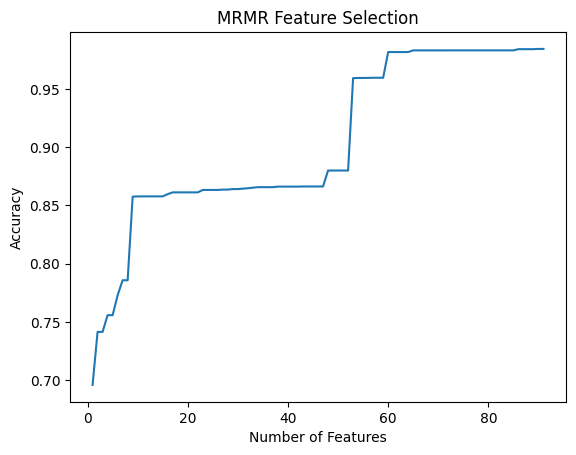

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Load the normalized dataset
df = pd.read_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Normalized.csv')

# Separate features and target variable
X = df.drop(['label', 'type'], axis=1)
y = df['label']

# Split the dataset into training and test data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# MRMR feature selection
accuracy_scores = []
num_features = []

for k in range(1, X.shape[1] + 1):
    selected_features = mrmr_classif(X=X, y=y, K=k)
    selected_indices = [X.columns.get_loc(feature) for feature in selected_features]  # Convert feature names to column indices
    X_selected = X.iloc[:, selected_indices]

    clf = DecisionTreeClassifier()
    clf.fit(X_selected, y)

    y_pred = clf.predict(X_selected)
    accuracy = accuracy_score(y, y_pred)

    accuracy_scores.append(accuracy)
    num_features.append(k)

# Plot the accuracy versus number of features
plt.plot(num_features, accuracy_scores)
plt.xlabel('Number of Features')
plt.ylabel('Accuracy')
plt.title('MRMR Feature Selection')
plt.show()

In [ ]:
!pip install skfeature-chappers

import pandas as pd
from sklearn.feature_selection import SelectKBest, chi2, mutual_info_classif
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from skfeature.function.statistical_based import gini_index
from skfeature.function.information_theoretical_based import MRMR
from sklearn.metrics import classification_report

# load the normalized dataset, which has been pre-processed from stage 3.1 to 3.7
df = pd.read_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Normalized.csv')

# Separate features and target variable
X = df.drop(['label', 'type'], axis=1)
y = df['label']

# Initialize the performance metric table
performance_table = pd.DataFrame(columns=['Method', 'Accuracy', 'Precision', 'Recall', 'F1-Score'])

# List of feature selection methods and their corresponding selectors
methods = ['Chi-square', 'Information Gain', 'Gini Impurity', 'MRMR']
selectors = [SelectKBest(chi2, k=10),
             SelectKBest(mutual_info_classif, k=10),
             SelectKBest(gini_index.gini_index, k=10),
             MRMR.mrmr]

# Perform feature selection and evaluate performance for each method
for method, selector in zip(methods, selectors):
    # Select features
    X_selected = selector.fit_transform(X, y)

    # Split the dataset into training and test sets
    X_train, X_test, y_train, y_test = train_test_split(X_selected, y, test_size=0.3, random_state=42)

    # Create and train the classifier
    classifier = DecisionTreeClassifier()
    classifier.fit(X_train, y_train)

    # Predict the target variable for test data
    y_pred = classifier.predict(X_test)

    # Calculate performance metrics
    report = classification_report(y_test, y_pred, output_dict=True)

    # Store performance metrics in the table
    performance_table = performance_table.append({'Method': method,
                                                  'Accuracy': report['accuracy'],
                                                  'Precision': report['macro avg']['precision'],
                                                  'Recall': report['macro avg']['recall'],
                                                  'F1-Score': report['macro avg']['f1-score']},
                                                 ignore_index=True)

# Print the performance metric table
print(performance_table)

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


KeyboardInterrupt: ignored

### 4.1.1 Feature selection using REF with random forest algorithm

In [ ]:
from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestClassifier

# Input: Dataset with 90 features
dataset = train_data

# Output: Dataset with 20 features
num_label_features = 20

while dataset.shape[1] > num_label_features:
    # Recursive Feature Elimination using Random Forest as estimator
    estimator = RandomForestClassifier()  # You can use any classifier of your choice
    selector = RFE(estimator, n_features_to_select=num_target_features)
    X = dataset.drop(columns=["label"])  # Assuming "label" is the target variable
    y = dataset["label"]
    selector.fit(X, y)

    # Get the mask of selected features
    feature_mask = selector.support_

    # Remove feature with lowest importance
    lowest_importance_index = min(range(len(feature_mask)), key=feature_mask.__getitem__)
    dataset = dataset.drop(columns=[dataset.columns[lowest_importance_index]])

# Output dataset after feature selection
output_dataset = dataset

# Save the output dataset
# output_dataset.to_csv("output_dataset.csv", index=False)


KeyboardInterrupt: ignored

### CS+DT+4Metrics

In [ ]:
# Chi-Square for FS + Decision Tree for Classification + Performance Metrics

from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Assuming 'X' is your feature matrix and 'y' is your target variable

# Perform feature selection using chi-square
k = 20  # Number of top features to select
selector = SelectKBest(chi2, k=k)
X_selected = selector.fit_transform(X, y)

# Get the selected feature indices
selected_feature_indices = selector.get_support(indices=True)

# Get the selected feature names
selected_feature_names = [X.columns[idx] for idx in selected_feature_indices]

# Print the feature importance scores
feature_scores = selector.scores_
feature_importance = list(zip(selected_feature_names, feature_scores))
feature_importance.sort(key=lambda x: x[1], reverse=True)
for feature, score in feature_importance:
    print(f"Feature: {feature}, Score: {score}")

# Split the data into training and test sets
# Assuming you have already split the data and obtained X_train, X_test, y_train, y_test

# Train a decision tree classifier on the selected features
clf = DecisionTreeClassifier()
clf.fit(X_selected, y_train)

# Make predictions on the test set
X_test_selected = X_test[:, selected_feature_indices]
y_test = clf.predict(X_test_selected)

# Calculate the performance metrics
accuracy = accuracy_score(y_test, y_test)
precision = precision_score(y_test, y_test, average='weighted')
recall = recall_score(y_test, y_test, average='weighted')
f1 = f1_score(y_test, y_test, average='weighted')

# Print the performance metrics
print(f"Accuracy: {accuracy}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1-score: {f1}")


Feature: dns_AA_T, Score: 79774.6164690624
Feature: srv_http, Score: 63810.551528206335
Feature: srv_dns, Score: 41578.74136560118
Feature: dns_AA_F, Score: 20053.678197814348
Feature: dns_rejected_0, Score: 13000.783337175028
Feature: dns_rejected_F, Score: 10591.56236066273
Feature: conn_state_SHR, Score: 2748.420669055042
Feature: dns_RA_F, Score: 2745.7395548023446
Feature: dns_RA_0, Score: 2248.8078231508453
Feature: dns_RD_0, Score: 1336.1168611807548
Feature: dns_rejected_T, Score: 826.0629521228509
Feature: dns_RD_F, Score: 42.266546555690475
Feature: conn_state_OTH, Score: 23.81480089750965
Feature: proto_udp, Score: 23.72829165525786
Feature: conn_state_REJ, Score: 5.683929239229972
Feature: conn_state_S1, Score: 4.2029899665891275
Feature: conn_state_S3, Score: 2.598198101792617
Feature: conn_state_S0, Score: 1.188439331359918
Feature: conn_state_SH, Score: 0.1599586641318966
Feature: proto_tcp, Score: 0.009041958695387467


ValueError: ignored

In [ ]:
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.metrics import classification_report

# load the normalized dataset, which has been pre-processed from stage 3.1 to 3.7
df = pd.read_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Normalized.csv')

# Separate features and target variable
X = df.drop(['label', 'type'], axis=1)
y = df['label']

# Apply CFS feature selection using a decision tree classifier
num_features_to_select = 10  # Number of features to select
cfs = SelectKBest(score_func=chi2, k=num_features_to_select)
X_cfs = cfs.fit_transform(X, y)

# Get the indices of the selected features
selected_feature_indices = cfs.get_support(indices=True)

# Get the names of the selected features
selected_features = X.columns[selected_feature_indices]

# Print the selected feature names
print("Selected Features:")
for feature in selected_features:
    print(feature)

# Split the dataset into training and test data, preserving class distribution
X_train, X_test, y_train, y_test = train_test_split(X_cfs, y, test_size=0.3, stratify=y, random_state=42)

# Train a decision tree classifier on the selected features
clf = DecisionTreeClassifier()
clf.fit(X_train, y_train)

# Predict using the trained model
y_pred = clf.predict(X_test)

# Evaluate performance
print("Classification Report:")
print(classification_report(y_test, y_pred))


Selected Features:
proto_tcp
proto_udp
conn_state_OTH
conn_state_REJ
srv_dns
srv_http
dns_AA_F
dns_RD_F
dns_RA_F
dns_rejected_F
Classification Report:
              precision    recall  f1-score   support

           0       0.92      0.85      0.88     86679
           1       0.76      0.87      0.81     48313

    accuracy                           0.86    134992
   macro avg       0.84      0.86      0.85    134992
weighted avg       0.87      0.86      0.86    134992



## 4.2 Classification

### 4.2.1 Binary Classification

#### 4.2.1.1 Binary Classification w/o Feature Selection using DT

In [ ]:
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.metrics import classification_report, confusion_matrix
import time
import psutil

# load the normalized dataset, which has been pre-processed from stage 3.1 to 3.7
df = pd.read_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Normalized.csv')

# Separate features and target variable
X = df.drop(['label', 'type'], axis=1)
y = df['label']

# Split the dataset into training and test data, preserving class distribution
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)

# Train the decision tree model with 5-fold cross-validation
clf = DecisionTreeClassifier()
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
scores = cross_val_score(clf, X_train, y_train, cv=cv)

# Train the decision tree model and measure the time, CPU usage, and memory consumption
start_time = time.time()
start_cpu = psutil.cpu_percent()
start_memory = psutil.virtual_memory().used

# Fit the classifier with the training data
clf.fit(X_train, y_train)

end_cpu = psutil.cpu_percent()
end_memory = psutil.virtual_memory().used
training_time = time.time() - start_time

# Predict using the trained model and measure the time, CPU usage, and memory consumption
start_time = time.time()
start_cpu_pred = psutil.cpu_percent()
start_memory_pred = psutil.virtual_memory().used

# Predict using the trained model on the test data
y_pred = clf.predict(X_test)

end_cpu_pred = psutil.cpu_percent()
end_memory_pred = psutil.virtual_memory().used
prediction_time = time.time() - start_time

# Calculate accuracy and false positive rate (FPR)
tn, fp, fn, tp = confusion_matrix(y_test, y_pred).ravel()
accuracy = (tp + tn) / (tp + tn + fp + fn)
fpr = fp / (fp + tn)

# Evaluate performance
print("Cross-Validation Scores:", scores)
print("Average Cross-Validation Score: %.4f" % scores.mean())
print("Classification Report:")
print(classification_report(y_test, y_pred, labels=clf.classes_))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))
print("Accuracy: %.4f" % accuracy)
print("False Positive Rate (FPR): %.4f" % fpr)
print("Training Time: %.4f seconds" % training_time)
print("Prediction Time: %.4f seconds" % prediction_time)
print("CPU Usage - Training: %.2f%%" % (end_cpu - start_cpu))
print("Memory Consumption - Training: %.2f MB" % ((end_memory - start_memory) / 1024 / 1024))
print("CPU Usage - Predicting: %.2f%%" % (end_cpu_pred - start_cpu_pred))
print("Memory Consumption - Predicting: %.2f MB" % ((end_memory_pred - start_memory_pred) / 1024 / 1024))

Cross-Validation Scores: [0.98425297 0.98242746 0.98250683 0.98352276 0.9849673 ]
Average Cross-Validation Score: 0.9835
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.98      0.99     86679
           1       0.96      0.99      0.98     48313

    accuracy                           0.98    134992
   macro avg       0.98      0.98      0.98    134992
weighted avg       0.98      0.98      0.98    134992

Confusion Matrix:
[[84866  1813]
 [  596 47717]]
Accuracy: 0.9822
False Positive Rate (FPR): 0.0209
Training Time: 1.6519 seconds
Prediction Time: 0.0431 seconds
CPU Usage - Training: 25.50%
Memory Consumption - Training: -2.39 MB
CPU Usage - Predicting: 55.60%
Memory Consumption - Predicting: 8.20 MB


#### Iteration to find the optimal feature sets with CS using DT

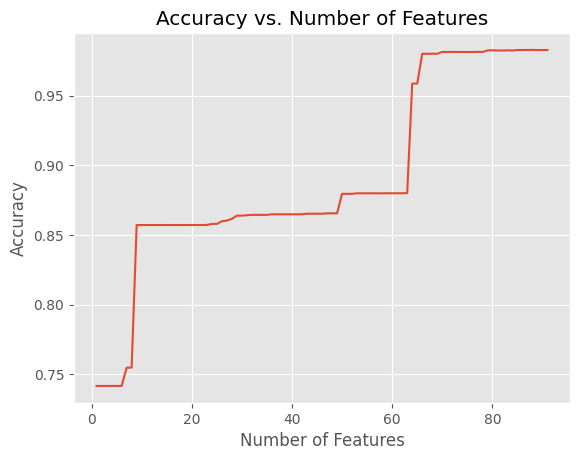

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Load the normalized dataset
df = pd.read_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Normalized.csv')

# Separate features and target variable
X = df.drop(['label', 'type'], axis=1)
y = df['label']

# Split the dataset into training and test data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize lists to store results
num_features = []
accuracies = []

# Iterate over different number of features
for k in range(1, len(X.columns) + 1):
    # Feature selection using chi-square
    selector = SelectKBest(score_func=chi2, k=k)
    X_train_selected = selector.fit_transform(X_train, y_train)
    X_test_selected = selector.transform(X_test)

    # Train the decision tree model
    clf = DecisionTreeClassifier()
    clf.fit(X_train_selected, y_train)

    # Predict on the test set
    y_pred = clf.predict(X_test_selected)

    # Calculate accuracy and store results
    accuracy = accuracy_score(y_test, y_pred)
    num_features.append(k)
    accuracies.append(accuracy)

# Plot the results
plt.plot(num_features, accuracies)
plt.xlabel('Number of Features')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Number of Features')
plt.show()


#### Iteration to do FS comparison with DT as base classifier

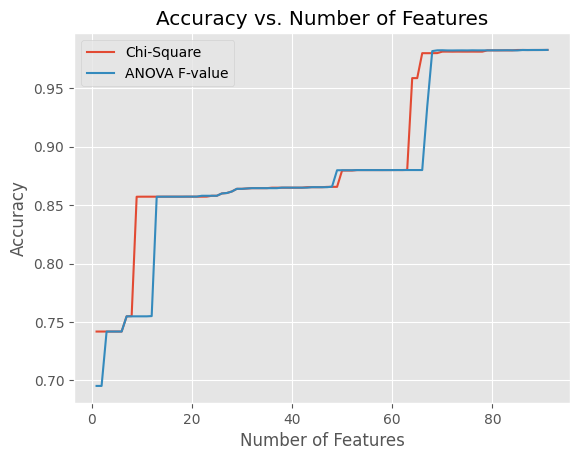

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier
from sklearn.feature_selection import SelectKBest, chi2, f_classif, mutual_info_classif
from scipy.stats import entropy
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score


# Load the normalized dataset
df = pd.read_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Normalized.csv')

# Separate features and target variable
X = df.drop(['label', 'type'], axis=1)
y = df['label']

# Split the dataset into training and test data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize lists to store results
num_features = []
accuracies_chi2 = []
accuracies_f_classif = []
#accuracies_mutual_info = []
#accuracies_gain_ratio = []
#accuracies_mrmr = []

# Iterate over different number of features
for k in range(1, len(X.columns) + 1):
    # Feature selection using chi-square
    selector_chi2 = SelectKBest(score_func=chi2, k=k)
    X_train_chi2 = selector_chi2.fit_transform(X_train, y_train)
    X_test_chi2 = selector_chi2.transform(X_test)

    # Feature selection using ANOVA F-value
    selector_f_classif = SelectKBest(score_func=f_classif, k=k)
    X_train_f_classif = selector_f_classif.fit_transform(X_train, y_train)
    X_test_f_classif = selector_f_classif.transform(X_test)

    # Feature selection using Mutual Information
    #selector_mutual_info = SelectKBest(score_func=mutual_info_classif, k=k)
    #X_train_mutual_info = selector_mutual_info.fit_transform(X_train, y_train)
    #X_test_mutual_info = selector_mutual_info.transform(X_test)

    # Train the decision tree model using chi-square selected features
    clf_chi2 = DecisionTreeClassifier()
    clf_chi2.fit(X_train_chi2, y_train)
    y_pred_chi2 = clf_chi2.predict(X_test_chi2)
    accuracy_chi2 = accuracy_score(y_test, y_pred_chi2)
    accuracies_chi2.append(accuracy_chi2)

    # Train the decision tree model using ANOVA F-value selected features
    clf_f_classif = DecisionTreeClassifier()
    clf_f_classif.fit(X_train_f_classif, y_train)
    y_pred_f_classif = clf_f_classif.predict(X_test_f_classif)
    accuracy_f_classif = accuracy_score(y_test, y_pred_f_classif)
    accuracies_f_classif.append(accuracy_f_classif)

    # Train the decision tree model using Mutual Information selected features
    #clf_mutual_info = DecisionTreeClassifier()
    #clf_mutual_info.fit(X_train_mutual_info, y_train)
    #y_pred_mutual_info = clf_mutual_info.predict(X_test_mutual_info)
    #accuracy_mutual_info = accuracy_score(y_test, y_pred_mutual_info)
    #accuracies_mutual_info.append(accuracy_mutual_info)

    # Feature selection using Gain Ratio
    #selector_gain_ratio = SelectKBest(score_func=gain_ratio, k=k)
    #X_train_gain_ratio = selector_gain_ratio.fit_transform(X_train, y_train)
    #X_test_gain_ratio = selector_gain_ratio.transform(X_test)

    # Train the decision tree model using Gain Ratio selected features
    #clf_gain_ratio = DecisionTreeClassifier()
    #clf_gain_ratio.fit(X_train_gain_ratio, y_train)
    #y_pred_gain_ratio = clf_gain_ratio.predict(X_test_gain_ratio)
    #accuracy_gain_ratio = accuracy_score(y_test, y_pred_gain_ratio)
    #accuracies_gain_ratio.append(accuracy_gain_ratio)

    # Feature selection using MRMR
    #selector_mrmr = SelectKBest(score_func=mrmr, k=k)
    #X_train_mrmr = selector_mrmr.fit_transform(X_train, y_train)
    #X_test_mrmr = selector_mrmr.transform(X_test)

    # Train the decision tree model using MRMR selected features
    #clf_mrmr = DecisionTreeClassifier()
    #clf_mrmr.fit(X_train_mrmr, y_train)
    #y_pred_mrmr = clf_mrmr.predict(X_test_mrmr)
    #accuracy_mrmr = accuracy_score(y_test, y_pred_mrmr)
    #accuracies_mrmr.append(accuracy_mrmr)

    num_features.append(k)

# Plot the results
plt.plot(num_features, accuracies_chi2, label='Chi-Square')
plt.plot(num_features, accuracies_f_classif, label='ANOVA F-value')
#plt.plot(num_features, accuracies_mutual_info, label='Mutual Information')
#plt.plot(num_features, accuracies_gain_ratio, label='Gain Ratio')
#plt.plot(num_features, accuracies_mrmr, label='MRMR')

plt.xlabel('Number of Features')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Number of Features')
plt.legend()
plt.show()


#### 4.2.2 Binary Classification w/o FS using DT, LR, NB, KNN, SVM, RF, Adaboost, Xgboost

This code iterates over multiple machine learning classifiers including Decision Tree, Logistic Regression, Naive Bayes, KNN, SVM, Random Forest, AdaBoost, and XGBoost. It performs cross-validation, trains the classifier, makes predictions, and evaluates the performance metrics for each classifier.

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from xgboost import XGBClassifier
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.metrics import classification_report, confusion_matrix
import time
import psutil

# Load the normalized dataset, which has been pre-processed
df = pd.read_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Normalized.csv')

# Separate features and target variable
X = df.drop(['label', 'type'], axis=1)
y = df['label']

# Split the dataset into training and test data, preserving class distribution
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)

classifiers = {
#    'Decision Tree': DecisionTreeClassifier(),
#    'Logistic Regression': LogisticRegression(),
#    'Naive Bayes': GaussianNB(),
#    'KNN': KNeighborsClassifier(),
    'SVM': SVC(),
#    'Random Forest': RandomForestClassifier(),
#    'AdaBoost': AdaBoostClassifier(),
#    'XGBoost': XGBClassifier()
}

for classifier_name, classifier in classifiers.items():
    print("Classifier:", classifier_name)

    # Train the classifier with 5-fold cross-validation and measure the time, CPU usage, and memory consumption
    # Record the start time, cpu, and memory
    start_time = time.time()
    start_cpu = psutil.cpu_percent()
    start_memory = psutil.virtual_memory().used

    # Train the classifier with 5-fold cross-validation
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    scores = cross_val_score(classifier, X_train, y_train, cv=cv)

    # Fit/Train the classifier with the whole training data
    classifier.fit(X_train, y_train)

    # Record end time and calcuate the time length, cpu, and memory
    training_time = time.time() - start_time
    end_cpu = psutil.cpu_percent()
    end_memory = psutil.virtual_memory().used


    # Predict using the trained model and measure the time, CPU usage, and memory consumption
    # Record the start time, cpu, and memory
    start_time = time.time()
    start_cpu_pred = psutil.cpu_percent()
    start_memory_pred = psutil.virtual_memory().used

    # Predict using the trained model on the test data
    y_pred = classifier.predict(X_test)

    # Record end time and calcuate the time length, cpu, and memory
    prediction_time = time.time() - start_time
    end_cpu_pred = psutil.cpu_percent()
    end_memory_pred = psutil.virtual_memory().used

    # Calculate accuracy and false positive rate (FPR)
    tn, fp, fn, tp = confusion_matrix(y_test, y_pred).ravel()
    accuracy = (tp + tn) / (tp + tn + fp + fn)
    fpr = fp / (fp + tn)

    # Evaluate performance
    print("Cross-Validation Scores:", scores)
    print("Average Cross-Validation Score: %.4f" % scores.mean())
    print("Classification Report:")
    print(classification_report(y_test, y_pred, labels=classifier.classes_))
    print("Confusion Matrix:")
    print(confusion_matrix(y_test, y_pred))
    print("Accuracy: %.4f" % accuracy)
    print("False Positive Rate (FPR): %.4f" % fpr)
    print("Training Time: %.4f seconds" % training_time)
    print("Prediction Time: %.4f seconds" % prediction_time)
    print("CPU Usage - Training: %.2f%%" % (end_cpu - start_cpu))
    print("Memory Consumption - Training: %.2f MB" % ((end_memory - start_memory) / 1024 / 1024))
    print("CPU Usage - Predicting: %.2f%%" % (end_cpu_pred - start_cpu_pred))
    print("Memory Consumption - Predicting: %.2f MB" % ((end_memory_pred - start_memory_pred) / 1024 / 1024))
    print("----------------------------------------")

Classifier: SVM


#### 4.2.1.3 Binary Classification with 10 Features by FS using DT, LR, NB, KNN, SVM, RF, Adaboost, Xgboost

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from xgboost import XGBClassifier
from sklearn.feature_selection import SelectKBest, chi2
from sklearn.metrics import classification_report, confusion_matrix
import time
import psutil

# Load the normalized dataset, which has been pre-processed
df = pd.read_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Normalized.csv')

# Separate features and target variable
X = df.drop(['label', 'type'], axis=1)
y = df['label']

# Apply CFS feature selection using correlation-based feature selection
start_time_fs = time.time()
start_cpu_fs = psutil.cpu_percent()
start_memory_fs = psutil.virtual_memory().used

cfs = SelectKBest(score_func=chi2, k=10)
X_cfs = cfs.fit_transform(X, y)

end_cpu_fs = psutil.cpu_percent()
end_memory_fs = psutil.virtual_memory().used
feature_selection_time = time.time() - start_time_fs

# Split the dataset into training and test data, preserving class distribution
X_train, X_test, y_train, y_test = train_test_split(X_cfs, y, test_size=0.3, stratify=y, random_state=42)

classifiers = {
    'Decision Tree': DecisionTreeClassifier(),
    'Logistic Regression': LogisticRegression(),
    'Naive Bayes': GaussianNB(),
    'KNN': KNeighborsClassifier(),
#    'SVM': SVC(),
    'Random Forest': RandomForestClassifier(),
    'AdaBoost': AdaBoostClassifier(),
    'XGBoost': XGBClassifier()
}

for classifier_name, classifier in classifiers.items():
    print("Classifier:", classifier_name)

    # Train the classifier with 5-fold cross-validation and measure the time, CPU usage, and memory consumption
    # Record the start time, cpu, and memory
    start_time = time.time()
    start_cpu = psutil.cpu_percent()
    start_memory = psutil.virtual_memory().used

    # Train the classifier with 5-fold cross-validation
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    scores = cross_val_score(classifier, X_train, y_train, cv=cv)

    # Fit/Train the classifier with the whole training data
    classifier.fit(X_train, y_train)

    # Record end time and calcuate the time length, cpu, and memory
    training_time = time.time() - start_time
    end_cpu = psutil.cpu_percent()
    end_memory = psutil.virtual_memory().used


    # Predict using the trained model and measure the time, CPU usage, and memory consumption
    # Record the start time, cpu, and memory
    start_time = time.time()
    start_cpu_pred = psutil.cpu_percent()
    start_memory_pred = psutil.virtual_memory().used

    # Predict using the trained model on the test data
    y_pred = classifier.predict(X_test)

    # Record end time and calcuate the time length, cpu, and memory
    prediction_time = time.time() - start_time
    end_cpu_pred = psutil.cpu_percent()
    end_memory_pred = psutil.virtual_memory().used


    # Calculate accuracy and false positive rate (FPR)
    tn, fp, fn, tp = confusion_matrix(y_test, y_pred).ravel()
    accuracy = (tp + tn) / (tp + tn + fp + fn)
    fpr = fp / (fp + tn)

    # Evaluate performance
    print("Feature Selection Time: %.4f seconds" % feature_selection_time)
    print("Cross-Validation Scores:", scores)
    print("Average Cross-Validation Score: %.4f" % scores.mean())
    print("Classification Report:")
    print(classification_report(y_test, y_pred, labels=classifier.classes_))
    print("Confusion Matrix:")
    print(confusion_matrix(y_test, y_pred))
    print("Accuracy: %.4f" % accuracy)
    print("False Positive Rate (FPR): %.4f" % fpr)
    print("Training Time: %.4f seconds" % training_time)
    print("Prediction Time: %.4f seconds" % prediction_time)
    print("CPU Usage - Training: %.2f%%" % (end_cpu - start_cpu))
    print("Memory Consumption - Training: %.2f MB" % ((end_memory - start_memory) / 1024 / 1024))
    print("CPU Usage - Predicting: %.2f%%" % (end_cpu_pred - start_cpu_pred))
    print("Memory Consumption - Predicting: %.2f MB" % ((end_memory_pred - start_memory_pred) / 1024 / 1024))
    print("----------------------------------------")

Classifier: Decision Tree
Feature Selection Time: 0.4379 seconds
Cross-Validation Scores: [0.85907042 0.85543527 0.85784812 0.85707029 0.85886405]
Average Cross-Validation Score: 0.8577
Classification Report:
              precision    recall  f1-score   support

           0       0.92      0.85      0.88     86679
           1       0.76      0.87      0.81     48313

    accuracy                           0.86    134992
   macro avg       0.84      0.86      0.85    134992
weighted avg       0.87      0.86      0.86    134992

Confusion Matrix:
[[73648 13031]
 [ 6133 42180]]
Accuracy: 0.8580
False Positive Rate (FPR): 0.1503
Training Time: 1.4610 seconds
Prediction Time: 0.0134 seconds
CPU Usage - Training: 0.00%
Memory Consumption - Training: 0.00 MB
CPU Usage - Predicting: 100.00%
Memory Consumption - Predicting: 0.00 MB
----------------------------------------
Classifier: Logistic Regression
Feature Selection Time: 0.4379 seconds
Cross-Validation Scores: [0.85876881 0.85521303 0.

#### Print the 10 features with their corresponding score

In [ ]:
from tabulate import tabulate

# Assuming X is your feature matrix and y is your target vector
cfs.fit(X, y)

# Get the scores of the selected features
scores = cfs.scores_[cfs.get_support()]

# Get the indices of the selected features
selected_features_indices = cfs.get_support(indices=True)

# Create a list of tuples containing the feature names and their scores
feature_scores = list(zip(X.columns[selected_features_indices], scores))

# Print the table
print(tabulate(feature_scores, headers=['Feature', 'Score']))

Feature           Score
--------------  -------
proto_tcp       41578.7
proto_udp       63810.6
conn_state_OTH  20053.7
conn_state_REJ  79774.6
srv_dns         36466.1
srv_http        15191.6
dns_AA_F        18928
dns_RD_F        34332.5
dns_RA_F        29754
dns_rejected_F  37728.4


Try to get the whole features with the score

In [ ]:
from operator import itemgetter

# Apply CFS feature selection using correlation-based feature selection
start_time_fs = time.time()

cfs = SelectKBest(score_func=chi2, k=20)
X_cfs = cfs.fit_transform(X, y)

feature_selection_time = time.time() - start_time_fs

# Get the scores of the selected features
scores = cfs.scores_[cfs.get_support()]

# Get the indices of the selected features
selected_features_indices = cfs.get_support(indices=True)

# Create a list of tuples containing the feature names and their scores
feature_scores = list(zip(X.columns[selected_features_indices], scores))

# Sort the list in descending order of scores
feature_scores_sorted = sorted(feature_scores, key=itemgetter(1), reverse=True)

# Print the table
print(tabulate(feature_scores_sorted, headers=['Feature', 'Score']))

Feature            Score
--------------  --------
conn_state_REJ  79774.6
proto_udp       63810.6
proto_tcp       41578.7
dns_rejected_F  37728.4
srv_dns         36466.1
dns_RD_F        34332.5
dns_RA_F        29754
conn_state_OTH  20053.7
dns_AA_F        18928
srv_http        15191.6
conn_state_S0   13000.8
conn_state_S3   11413.4
conn_state_S1   10591.6
dns_rejected_T   9668.18
conn_state_SHR   9343.45
dns_AA_T         8103.75
conn_state_SH    7284.37
dns_RD_0         7038.16
dns_RA_0         7038.16
dns_rejected_0   7038.16


#### 4.2.1.4 Binary Classification with 20 Features by FS using DT, LR, NB, KNN, SVM, RF, Adaboost, Xgboost

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from xgboost import XGBClassifier
from sklearn.feature_selection import SelectKBest, chi2
from sklearn.metrics import classification_report, confusion_matrix
import time
import psutil

# Load the normalized dataset, which has been pre-processed
df = pd.read_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Normalized.csv')

# Separate features and target variable
X = df.drop(['label', 'type'], axis=1)
y = df['label']

# Apply CFS feature selection using correlation-based feature selection
start_time_fs = time.time()
start_cpu_fs = psutil.cpu_percent()
start_memory_fs = psutil.virtual_memory().used

cfs = SelectKBest(score_func=chi2, k=20)
X_cfs = cfs.fit_transform(X, y)

end_cpu_fs = psutil.cpu_percent()
end_memory_fs = psutil.virtual_memory().used
feature_selection_time = time.time() - start_time_fs

# Split the dataset into training and test data, preserving class distribution
X_train, X_test, y_train, y_test = train_test_split(X_cfs, y, test_size=0.3, stratify=y, random_state=42)

classifiers = {
    'Decision Tree': DecisionTreeClassifier(),
    'Logistic Regression': LogisticRegression(),
    'Naive Bayes': GaussianNB(),
    'KNN': KNeighborsClassifier(),
#    'SVM': SVC(),
    'Random Forest': RandomForestClassifier(),
    'AdaBoost': AdaBoostClassifier(),
    'XGBoost': XGBClassifier()
}

for classifier_name, classifier in classifiers.items():
    print("Classifier:", classifier_name)

    # Train the classifier with 5-fold cross-validation and measure the time, CPU usage, and memory consumption
    # Record the start time, cpu, and memory
    start_time = time.time()
    start_cpu = psutil.cpu_percent()
    start_memory = psutil.virtual_memory().used

    # Train the classifier with 5-fold cross-validation
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    scores = cross_val_score(classifier, X_train, y_train, cv=cv)

    # Fit/Train the classifier with the whole training data
    classifier.fit(X_train, y_train)

    # Record end time and calcuate the time length, cpu, and memory
    training_time = time.time() - start_time
    end_cpu = psutil.cpu_percent()
    end_memory = psutil.virtual_memory().used


    # Predict using the trained model and measure the time, CPU usage, and memory consumption
    # Record the start time, cpu, and memory
    start_time = time.time()
    start_cpu_pred = psutil.cpu_percent()
    start_memory_pred = psutil.virtual_memory().used

    # Predict using the trained model on the test data
    y_pred = classifier.predict(X_test)

    # Record end time and calcuate the time length, cpu, and memory
    prediction_time = time.time() - start_time
    end_cpu_pred = psutil.cpu_percent()
    end_memory_pred = psutil.virtual_memory().used


    # Calculate accuracy and false positive rate (FPR)
    tn, fp, fn, tp = confusion_matrix(y_test, y_pred).ravel()
    accuracy = (tp + tn) / (tp + tn + fp + fn)
    fpr = fp / (fp + tn)

    # Evaluate performance
    print("Feature Selection Time: %.4f seconds" % feature_selection_time)
    print("Cross-Validation Scores:", scores)
    print("Average Cross-Validation Score: %.4f" % scores.mean())
    print("Classification Report:")
    print(classification_report(y_test, y_pred, labels=classifier.classes_))
    print("Confusion Matrix:")
    print(confusion_matrix(y_test, y_pred))
    print("Accuracy: %.4f" % accuracy)
    print("False Positive Rate (FPR): %.4f" % fpr)
    print("Training Time: %.4f seconds" % training_time)
    print("Prediction Time: %.4f seconds" % prediction_time)
    print("CPU Usage - Training: %.2f%%" % (end_cpu - start_cpu))
    print("Memory Consumption - Training: %.2f MB" % ((end_memory - start_memory) / 1024 / 1024))
    print("CPU Usage - Predicting: %.2f%%" % (end_cpu_pred - start_cpu_pred))
    print("Memory Consumption - Predicting: %.2f MB" % ((end_memory_pred - start_memory_pred) / 1024 / 1024))
    print("----------------------------------------")

Classifier: Decision Tree
Feature Selection Time: 0.3148 seconds
Cross-Validation Scores: [0.85930853 0.85562575 0.85805448 0.85753064 0.85911804]
Average Cross-Validation Score: 0.8579
Classification Report:
              precision    recall  f1-score   support

           0       0.92      0.85      0.89     86679
           1       0.76      0.87      0.82     48313

    accuracy                           0.86    134992
   macro avg       0.84      0.86      0.85    134992
weighted avg       0.87      0.86      0.86    134992

Confusion Matrix:
[[73646 13033]
 [ 6089 42224]]
Accuracy: 0.8583
False Positive Rate (FPR): 0.1504
Training Time: 2.0020 seconds
Prediction Time: 0.0136 seconds
CPU Usage - Training: -1.20%
Memory Consumption - Training: 0.68 MB
CPU Usage - Predicting: 66.70%
Memory Consumption - Predicting: 0.00 MB
----------------------------------------
Classifier: Logistic Regression


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

Feature Selection Time: 0.3148 seconds
Cross-Validation Scores: [0.8589593  0.85538764 0.85770525 0.85718141 0.85876881]
Average Cross-Validation Score: 0.8576
Classification Report:
              precision    recall  f1-score   support

           0       0.92      0.85      0.88     86679
           1       0.76      0.87      0.82     48313

    accuracy                           0.86    134992
   macro avg       0.84      0.86      0.85    134992
weighted avg       0.87      0.86      0.86    134992

Confusion Matrix:
[[73629 13050]
 [ 6101 42212]]
Accuracy: 0.8581
False Positive Rate (FPR): 0.1506
Training Time: 24.3438 seconds
Prediction Time: 0.0067 seconds
CPU Usage - Training: 43.10%
Memory Consumption - Training: 9.66 MB
CPU Usage - Predicting: 100.00%
Memory Consumption - Predicting: 0.00 MB
----------------------------------------
Classifier: Naive Bayes
Feature Selection Time: 0.3148 seconds
Cross-Validation Scores: [0.70904502 0.70952124 0.7089339  0.70710839 0.70555273]


### 4.2.2 Multi Classification

#### 4.2.2.1 Multi-classification w/o FS using DT

In [ ]:
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedKFold, cross_val_score
from sklearn.preprocessing import LabelEncoder
import time
import psutil

# Load the normalized dataset, which has been pre-processed from stage 3.1 to 3.7
df = pd.read_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Normalized.csv')

# Separate features and target variable
X = df.drop(['label', 'type'], axis=1)
y = df['type']

# Encode the target variable
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Split the dataset into training and test data, preserving class distribution
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)

# Train the decision tree model with 5-fold cross-validation
clf = DecisionTreeClassifier()
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
scores = cross_val_score(clf, X_train, y_train, cv=cv)

# Train the decision tree model and measure the time, CPU usage, and memory consumption
start_time = time.time()
start_cpu = psutil.cpu_percent()
start_memory = psutil.virtual_memory().used

# Fit the classifier with the training data
clf.fit(X_train, y_train)

end_cpu = psutil.cpu_percent()
end_memory = psutil.virtual_memory().used
training_time = time.time() - start_time

# Predict using the trained model and measure the time, CPU usage, and memory consumption
start_time = time.time()
start_cpu_pred = psutil.cpu_percent()
start_memory_pred = psutil.virtual_memory().used

# Predict using the trained model on the test data
y_pred = clf.predict(X_test)

end_cpu_pred = psutil.cpu_percent()
end_memory_pred = psutil.virtual_memory().used
prediction_time = time.time() - start_time

# Calculate accuracy and false positive rate (FPR) for multi-class classification
cm = confusion_matrix(y_test, y_pred)
accuracy = sum(cm.diagonal()) / cm.sum()

fpr = []
for i in range(cm.shape[0]):
    total_predicted_negative = cm[:, i].sum() - cm[i, i]
    fpr_class = cm[i, :].sum() - cm[i, i] / (cm[i, i] + total_predicted_negative)
    fpr.append(fpr_class)

# Evaluate performance
print("Cross-Validation Scores:", scores)
print("Average Cross-Validation Score: %.4f" % scores.mean())
print("Classification Report:")
print(classification_report(y_test, y_pred, labels=clf.classes_, target_names=label_encoder.classes_))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))
print("Accuracy: %.4f" % accuracy)
print("False Positive Rate (FPR): %.4f" % (sum(fpr) / len(fpr)))
print("Training Time: %.4f seconds" % training_time)
print("Prediction Time: %.4f seconds" % prediction_time)
print("CPU Usage - Training: %.2f%%" % (end_cpu - start_cpu))
print("Memory Consumption - Training: %.2f MB" % ((end_memory - start_memory) / 1024 / 1024))
print("CPU Usage - Predicting: %.2f%%" % (end_cpu_pred - start_cpu_pred))
print("Memory Consumption - Predicting: %.2f MB" % ((end_memory_pred - start_memory_pred) / 1024 / 1024))


Cross-Validation Scores: [0.93359896 0.93678964 0.9357102  0.93450378 0.93532923]
Average Cross-Validation Score: 0.9352
Classification Report:
              precision    recall  f1-score   support

    backdoor       0.54      1.00      0.70      6000
        ddos       0.99      0.95      0.97      6000
         dos       0.94      0.23      0.37      6000
   injection       0.98      0.94      0.96      6000
        mitm       0.67      0.74      0.71       313
      normal       0.99      0.98      0.99     86679
    password       0.98      0.98      0.98      6000
  ransomware       0.83      0.97      0.90      6000
    scanning       0.83      0.83      0.83      6000
         xss       0.91      0.92      0.91      6000

    accuracy                           0.93    134992
   macro avg       0.87      0.85      0.83    134992
weighted avg       0.95      0.93      0.93    134992

Confusion Matrix:
[[ 5995     2     0     0     0     3     0     0     0     0]
 [    2  5717   

#### Transform multiple classificaiton for multiple classes, into binary classification for each class

In [ ]:
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedKFold, cross_val_score
from sklearn.preprocessing import LabelEncoder
import time
import psutil

# Load the normalized dataset, which has been pre-processed from stage 3.1 to 3.7
df = pd.read_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Normalized.csv')

# Separate features and target variable
X = df.drop(['label', 'type'], axis=1)
y = df['type']

# Encode the target variable
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Split the dataset into training and test data, preserving class distribution
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)

# Train a separate decision tree model for each class
classifiers = []
predictions = []

for class_label in set(y):
    # Create binary labels for the current class
    y_train_binary = (y_train == class_label).astype(int)
    y_test_binary = (y_test == class_label).astype(int)

    # Train the decision tree model
    clf = DecisionTreeClassifier()
    clf.fit(X_train, y_train_binary)
    classifiers.append(clf)

    # Predict using the trained model
    y_pred_binary = clf.predict(X_test)
    predictions.append(y_pred_binary)

# Evaluate performance for each class
for i, clf in enumerate(classifiers):
    class_label = label_encoder.inverse_transform([i])[0]
    y_pred_binary = predictions[i]

    # Calculate accuracy and false positive rate (FPR)
    tn, fp, fn, tp = confusion_matrix(y_test_binary, y_pred_binary).ravel()
    accuracy = (tp + tn) / (tp + tn + fp + fn)
    fpr = fp / (fp + tn)

    # Print performance metrics for the current class
    print("Class: ", class_label)
    print("Classification Report:")
    print(classification_report(y_test_binary, y_pred_binary))
    print("Confusion Matrix:")
    print(confusion_matrix(y_test_binary, y_pred_binary))
    print("Accuracy: %.4f" % accuracy)
    print("False Positive Rate (FPR): %.4f" % fpr)
    print()

Class:  backdoor
Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.91      0.93    128992
           1       0.00      0.00      0.00      6000

    accuracy                           0.87    134992
   macro avg       0.48      0.46      0.47    134992
weighted avg       0.91      0.87      0.89    134992

Confusion Matrix:
[[117877  11115]
 [  6000      0]]
Accuracy: 0.8732
False Positive Rate (FPR): 0.0862

Class:  ddos
Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.96      0.95    128992
           1       0.00      0.00      0.00      6000

    accuracy                           0.91    134992
   macro avg       0.48      0.48      0.48    134992
weighted avg       0.91      0.91      0.91    134992

Confusion Matrix:
[[123213   5779]
 [  5984     16]]
Accuracy: 0.9129
False Positive Rate (FPR): 0.0448

Class:  dos
Classification Report:
              precision  

## PCA to display the instances

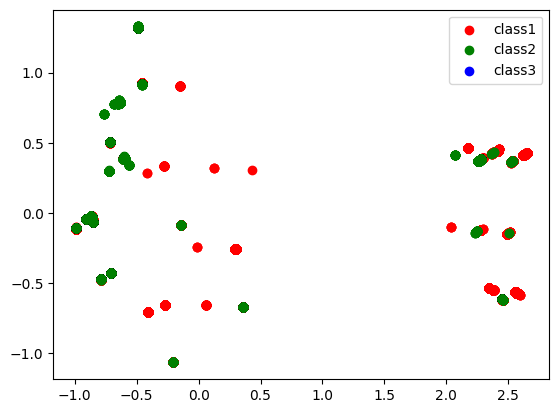

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

# Load the normalized dataset, which has been pre-processed
df = pd.read_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Normalized.csv')

# Separate features and target variable
X = df.drop(['label', 'type'], axis=1)
y = df['label']

# 进行PCA降维
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# 将降维后的数据和标签合并
df_pca = pd.DataFrame(X_pca, columns=['PC1', 'PC2'])
df_pca['label'] = y

# 绘制散点图
colors = ['red', 'green', 'blue']  # 每个类别对应的颜色
labels = ['class1', 'class2', 'class3']  # 每个类别对应的标签
fig, ax = plt.subplots()
for i, label in enumerate(labels):
    ax.scatter(df_pca.loc[df_pca['label'] == i, 'PC1'],
               df_pca.loc[df_pca['label'] == i, 'PC2'],
               c=colors[i],
               label=label)
ax.legend()
plt.show()


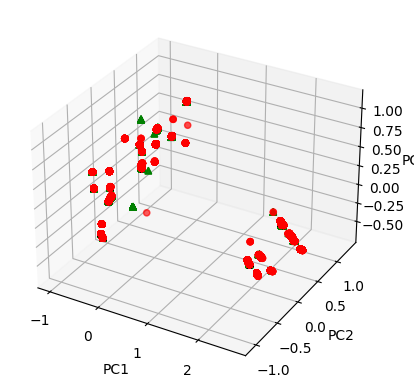

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.decomposition import PCA

# Load the normalized dataset, which has been pre-processed
df = pd.read_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Normalized.csv')

# Separate features and target variable
X = df.drop(['label', 'type'], axis=1)
y = df['label']

# 进行PCA降维
pca = PCA(n_components=3)
X_pca = pca.fit_transform(X)

# 将降维后的数据和标签合并
df_pca = pd.DataFrame(X_pca, columns=['PC1', 'PC2', 'PC3'])
df_pca['label'] = y

# 绘制3D散点图
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
colors = ['red', 'green']  # 每个类别对应的颜色
markers = ['o', '^']  # 每个类别对应的标记
for i in range(2):
    ax.scatter(df_pca.loc[df_pca['label'] == i, 'PC1'],
               df_pca.loc[df_pca['label'] == i, 'PC2'],
               df_pca.loc[df_pca['label'] == i, 'PC3'],
               c=colors[i], marker=markers[i])
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')
plt.show()


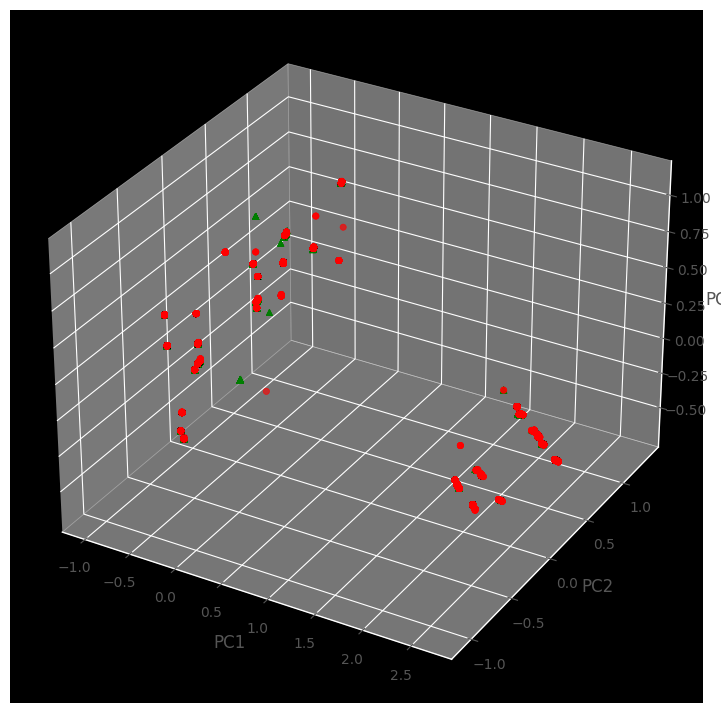

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.decomposition import PCA

# 读取数据集
df = pd.read_csv('/content/drive/MyDrive/Datasets/TON-IoT/TON-IoT_Normalized.csv')

# 获取特征和标签
# Separate features and target variable
X = df.drop(['label', 'type'], axis=1)
y = df['label']

# 进行PCA降维
pca = PCA(n_components=3)
X_pca = pca.fit_transform(X)

# 将降维后的数据和标签合并
df_pca = pd.DataFrame(X_pca, columns=['PC1', 'PC2', 'PC3'])
df_pca['label'] = y

# 绘制3D散点图
fig = plt.figure(figsize=(12, 9))  # 将图像尺寸放大2倍
ax = fig.add_subplot(111, projection='3d')
ax.set_facecolor('black')  # 将背景改为黑色
colors = ['red', 'green']  # 每个类别对应的颜色
markers = ['o', '^']  # 每个类别对应的标记
for i in range(2):
    ax.scatter(df_pca.loc[df_pca['label'] == i, 'PC1'],
               df_pca.loc[df_pca['label'] == i, 'PC2'],
               df_pca.loc[df_pca['label'] == i, 'PC3'],
               c=colors[i], marker=markers[i])
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')
plt.show()